In [1]:
PROJDIR=file.path('../../../data/raw_data/cross_species_peak_orthologs')

#######################################
### set up libraries and functions ####
ss <- function(x, pattern, slot = 1, ...) { 
  sapply(strsplit(x = x, split = pattern, ...), '[', slot) }
options(stringsAsFactors = F, repr.plot.width=14, repr.plot.height=6)
suppressMessages(library(Signac)); suppressMessages(library(Seurat))
suppressMessages(library(harmony))

source('../hal_scripts/narrowPeakFunctions.R')

In [2]:
# # set up future for parallelization
library(future)
library(future.apply)
plan("multiprocess", workers = parallel::detectCores()/4)
options(future.globals.maxSize = 80000 * 1024^2)

# 1) visualize unintegrated species clusters

In [3]:
## load the seurat object
saveRDS_fn = file.path(PROJDIR, 'rdas', 'multispeciesMergedSeurat.rds')
obj_seurat = readRDS(file = saveRDS_fn)

##  TF-IDF, SVD, and UMAP already performed on 'peaks' matrix
obj_seurat

An object of class Seurat 
261475 features across 54472 samples within 1 assay 
Active assay: peaks (261475 features, 261475 variable features)
 2 dimensional reductions calculated: lsi, umap

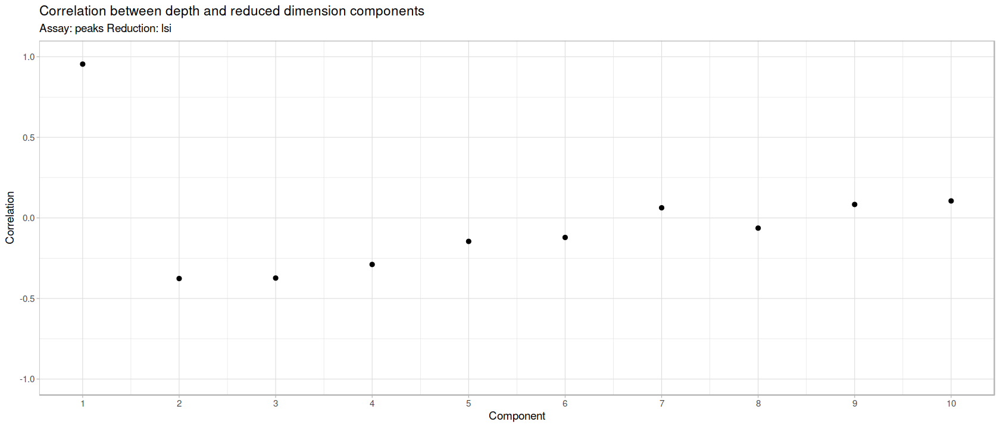

In [4]:
DepthCor(obj_seurat) # drop the first PC

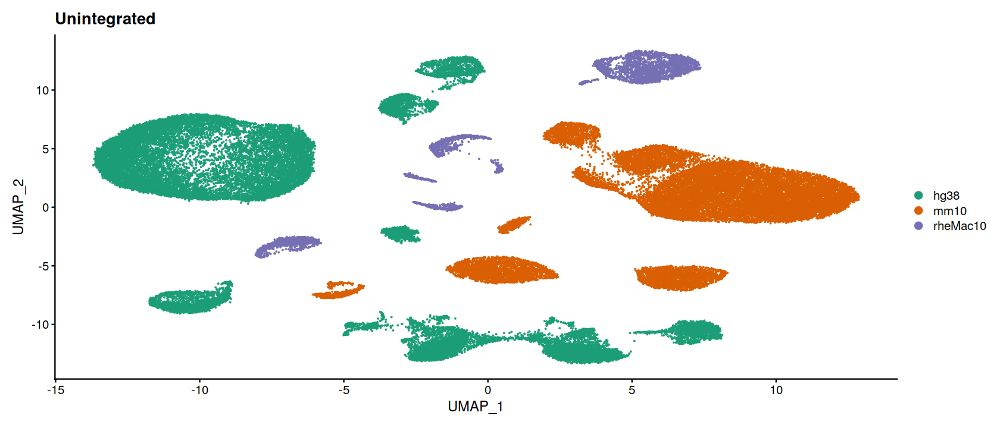

In [5]:
p_unintegrated_species = 
    DimPlot(object = obj_seurat, label = FALSE, group.by = 'Species', cols = 'Dark2') + 
    ggplot2::ggtitle("Unintegrated")
p_unintegrated_species

Warning message:
"Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session."


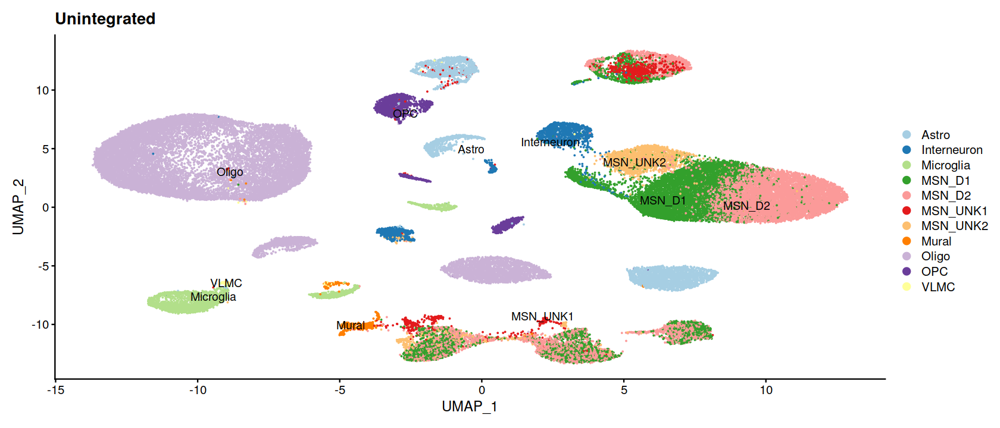

In [6]:
p_unintegrated_clusters2 = 
    DimPlot(object = obj_seurat, label = TRUE, group.by = 'Clusters2', cols = 'Paired') + 
    ggplot2::ggtitle("Unintegrated")
p_unintegrated_clusters2

# 2) integration with Harmony

In [7]:
# split seurat object up by Species
set.seed(42)
cellNamesList = split(rownames(obj_seurat@meta.data), obj_seurat$Species)
cellNames = unlist(lapply(cellNamesList, sample, 5000))
subsetObj_seurat = subset(obj_seurat,cells = cellNames )

In [8]:
harmonize = function(obj,  group.by.vars, theta){
    set.seed(42)
    objHarmony <- RunHarmony(obj, group.by.vars = group.by.vars, theta = theta, nclust = 20,
                            reduction.save = "harmony", reduction = "lsi", dims.use = 2:30,
                             assay.use = "peaks", project.dim = FALSE,
                            max.iter.harmony = 20, max.iter.cluster = 30)

    # re-compute the UMAP using corrected LSI embeddings
    objHarmony <- RunUMAP(object = objHarmony, umap.method = "uwot", 
                          verbose = FALSE, reduction = 'harmony', dims = 2:30)

    title = paste("Harmony",
                  "group:", paste(group.by.vars, collapse = ', '),
                  'theta:',paste(theta, collapse = ', ') )

    # plot embeddings
    p_integrated_species = 
        DimPlot(object = objHarmony, label = FALSE, group.by = 'Species', cols = 'Dark2') +
        ggplot2::ggtitle(title)
    
    p_integrated_clusters2 = 
        DimPlot(object = objHarmony, label = TRUE, group.by = 'Clusters2', cols = 'Paired') +
        ggplot2::ggtitle(title)

    p = p_integrated_species + p_integrated_clusters2
    return(p)
}

# 3) compare integrated snATAC-seq cell types

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



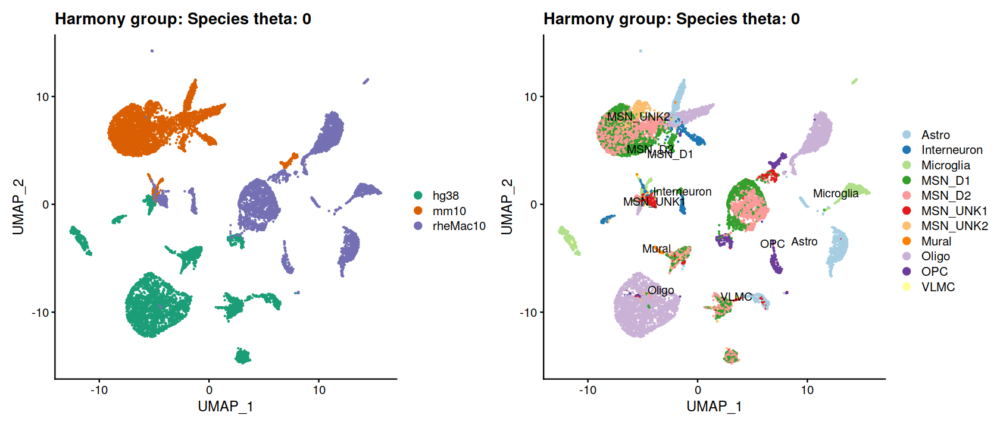

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



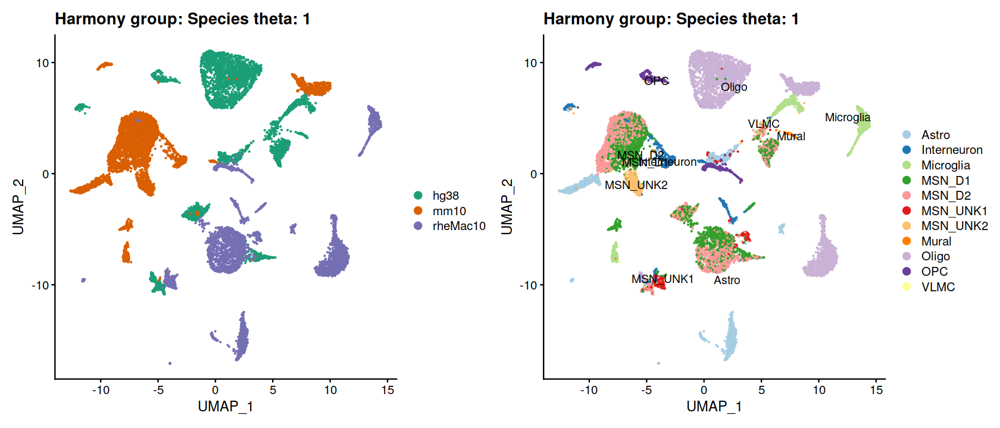

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



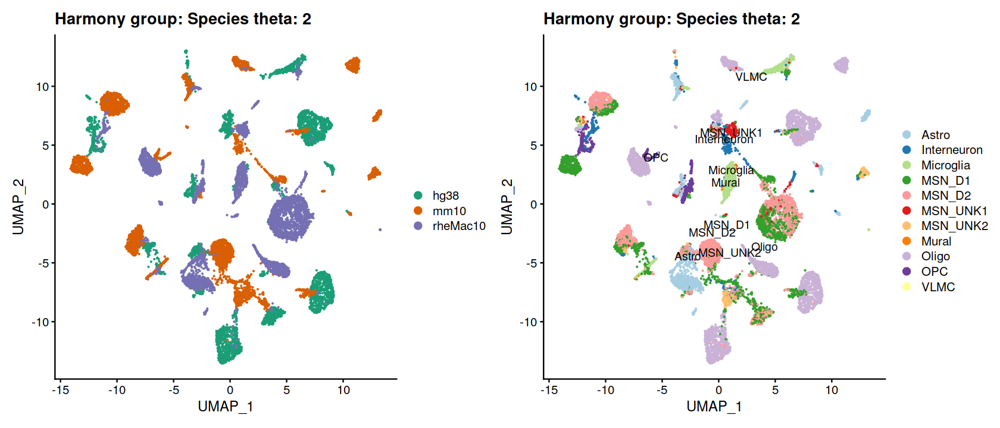

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony converged after 8 iterations



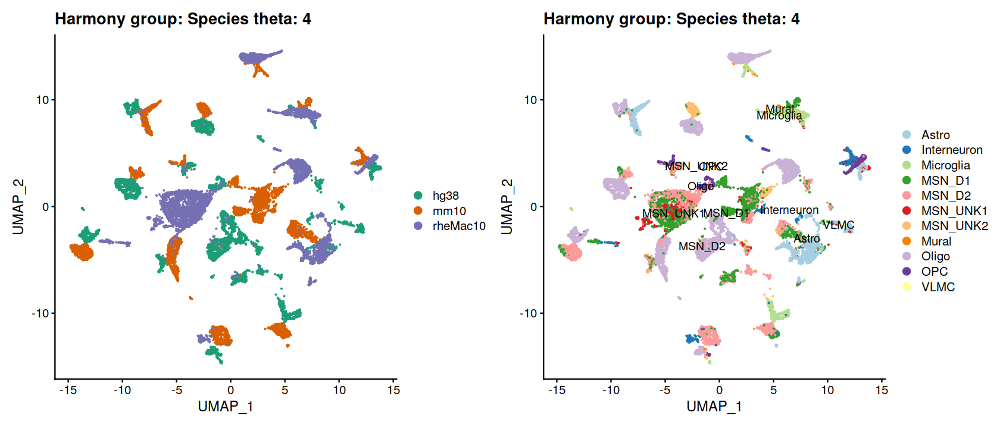

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



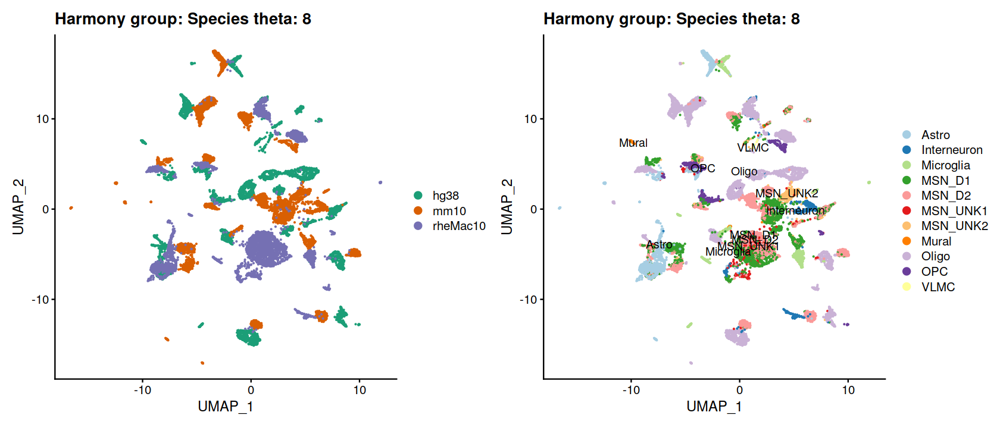

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



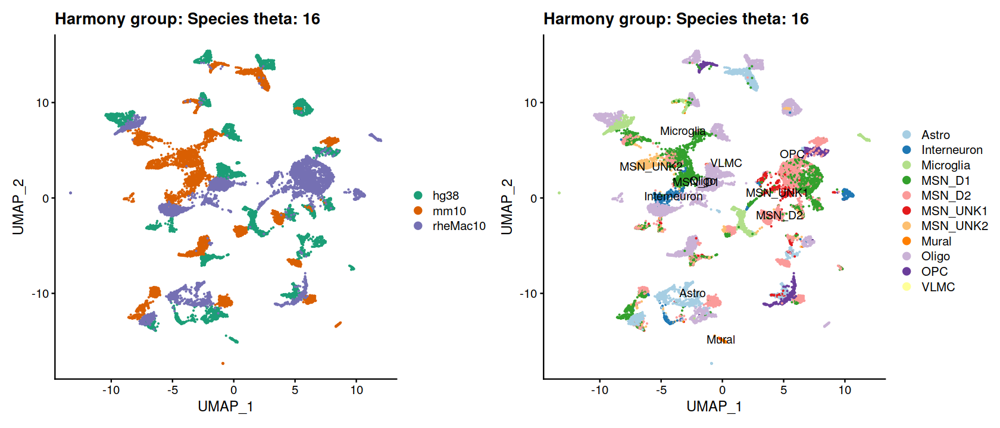

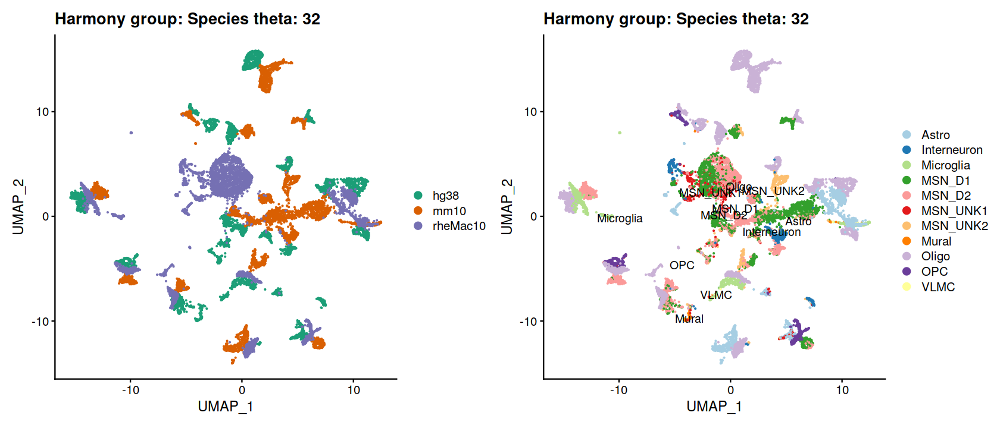

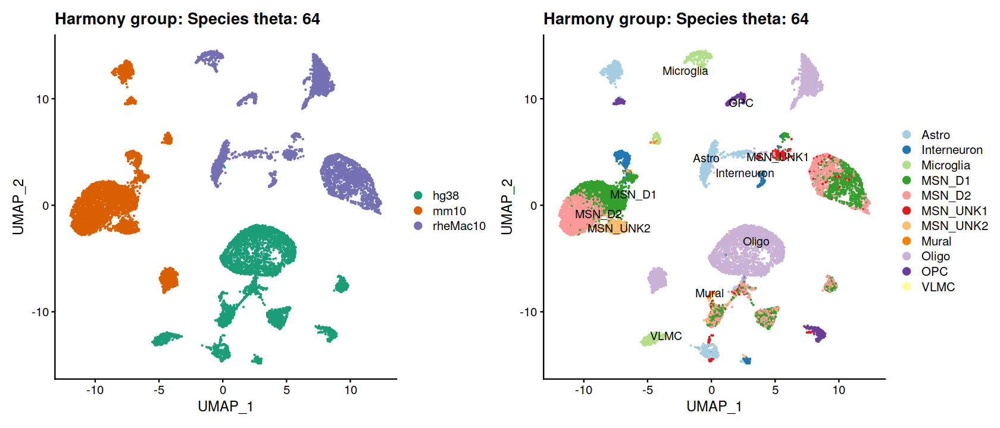

In [9]:
for(theta in c(0,2^(0:6))){
    p = harmonize(obj = subsetObj_seurat, group.by.vars = 'Species', theta = theta)
    print(p)
}

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations

Harmony 1/20

Harmony 2/20

Harmony converged after 2 iterations



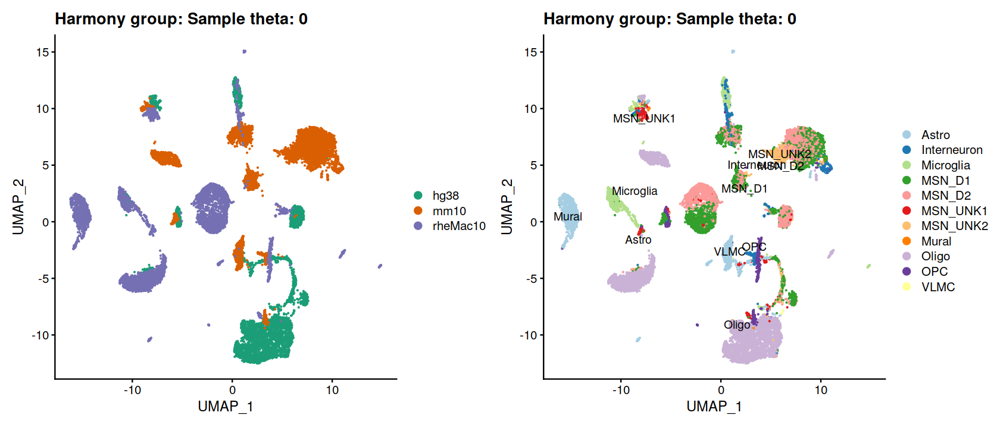

Harmony 1/20

Harmony 2/20

Harmony converged after 2 iterations



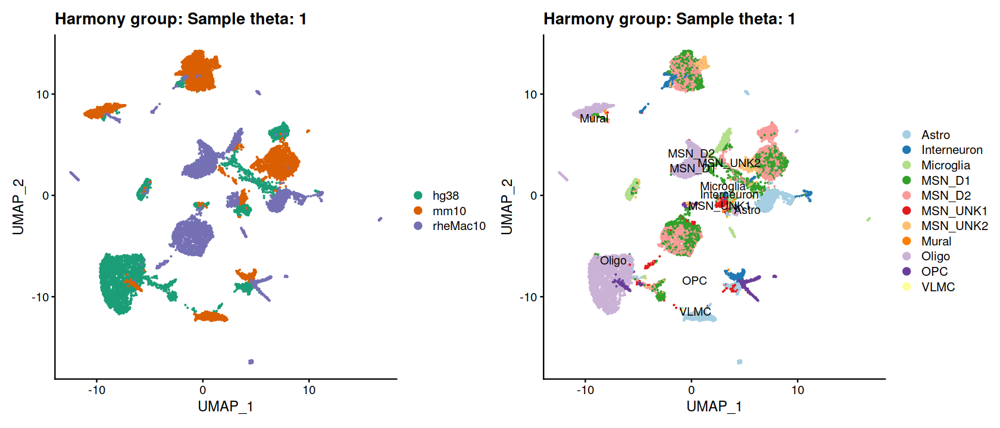

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony converged after 13 iterations



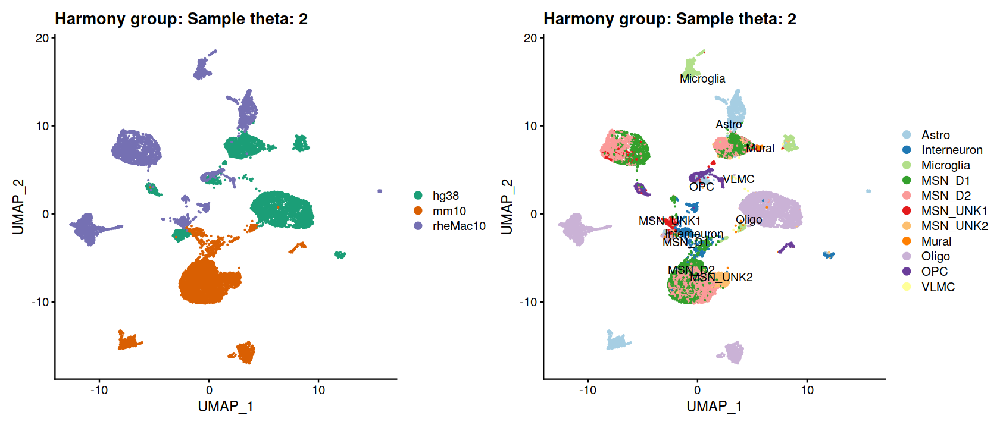

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



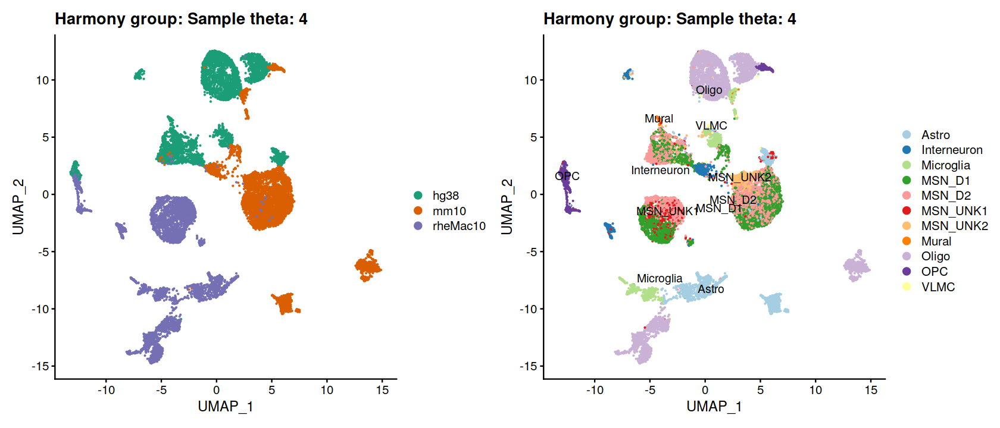

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



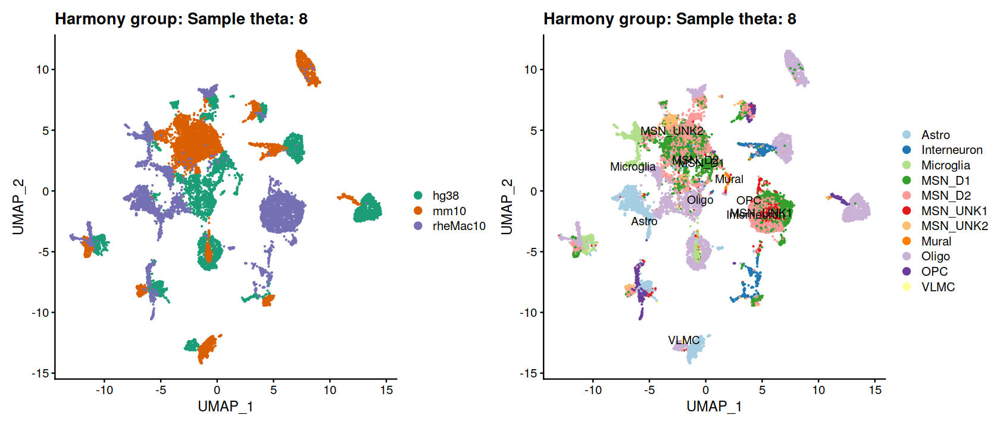

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony converged after 5 iterations



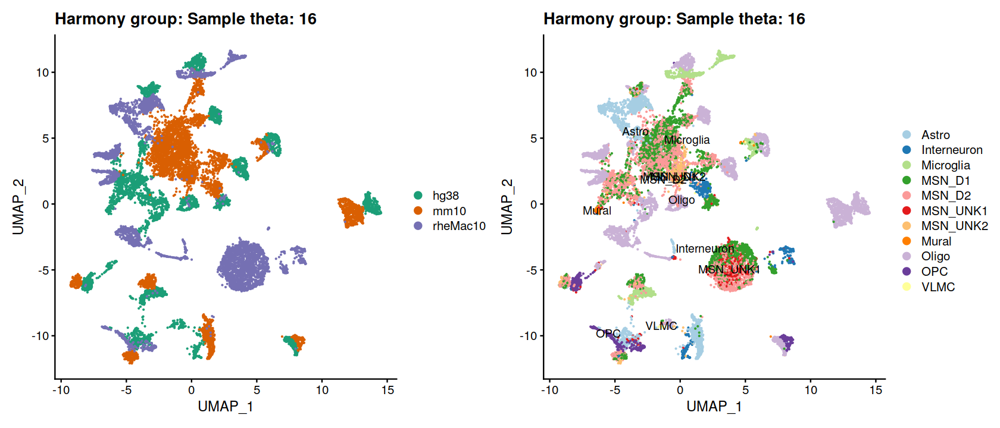

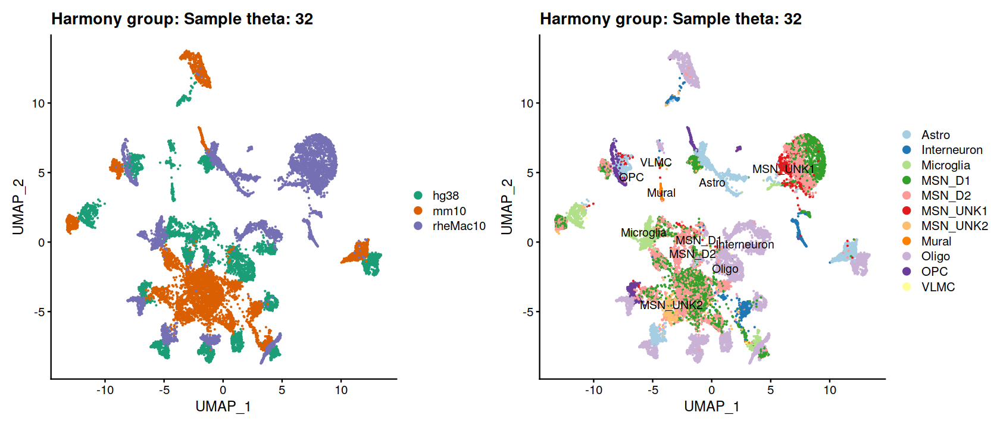

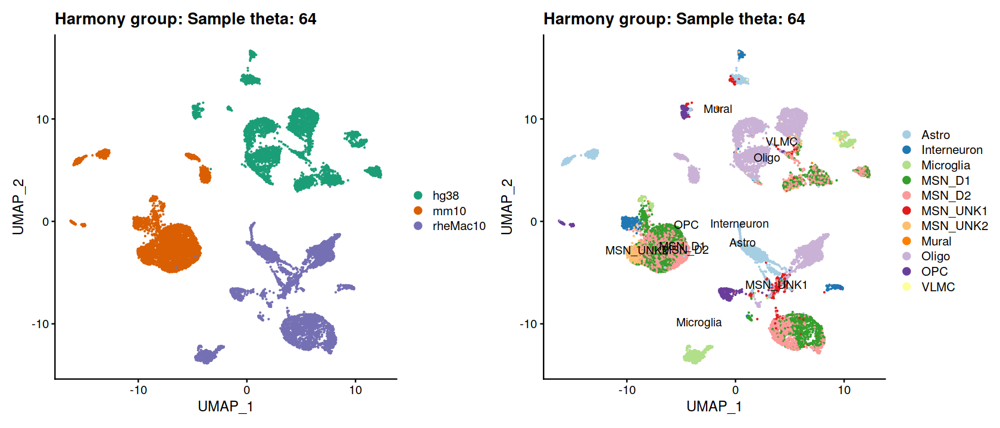

In [10]:
for(theta in c(0,2^(0:6))){
    p = harmonize(obj = subsetObj_seurat, group.by.vars = 'Sample', theta = theta)
    print(p)
}

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



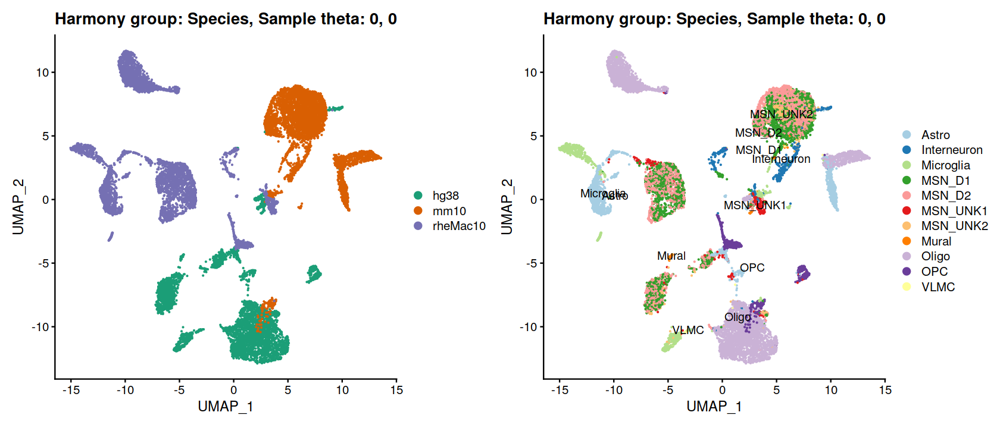

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



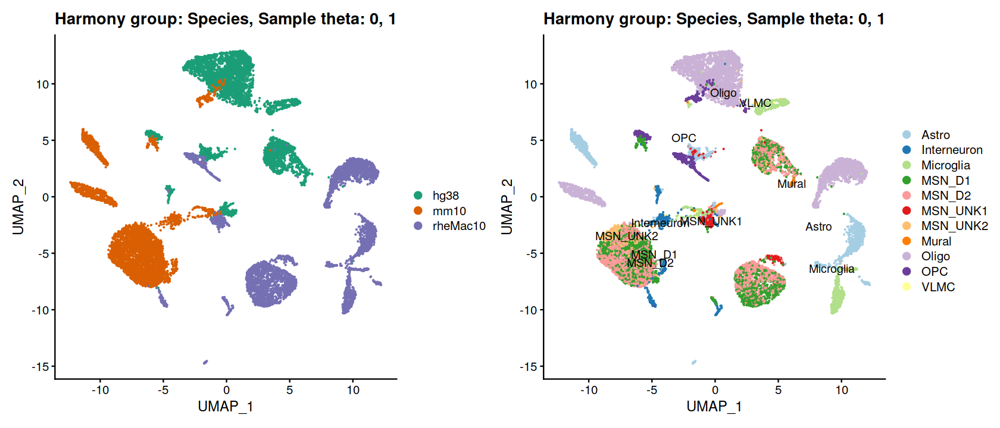

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



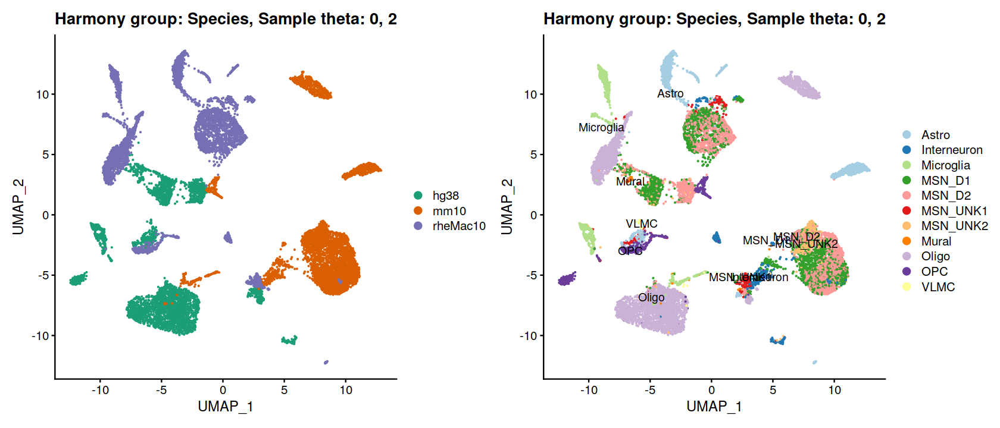

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



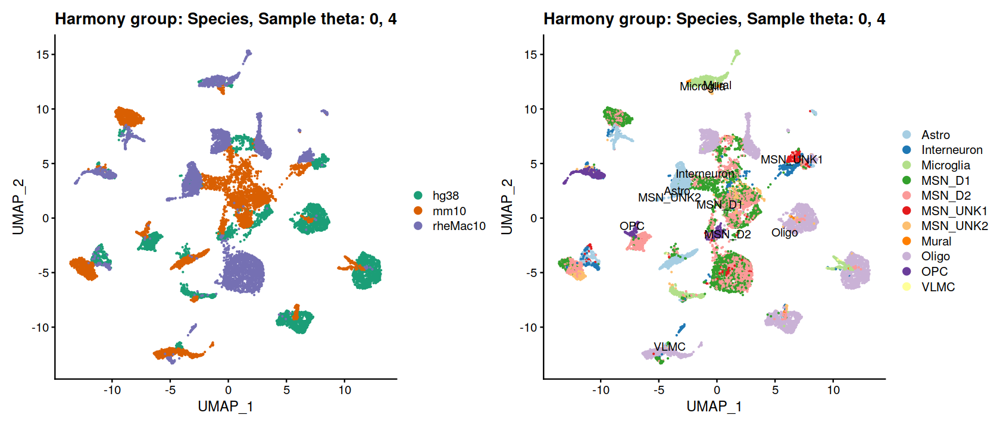

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



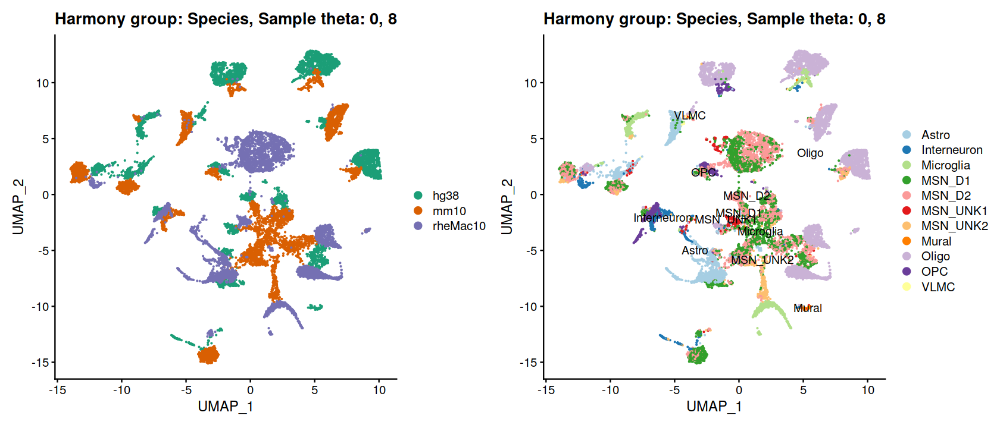

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



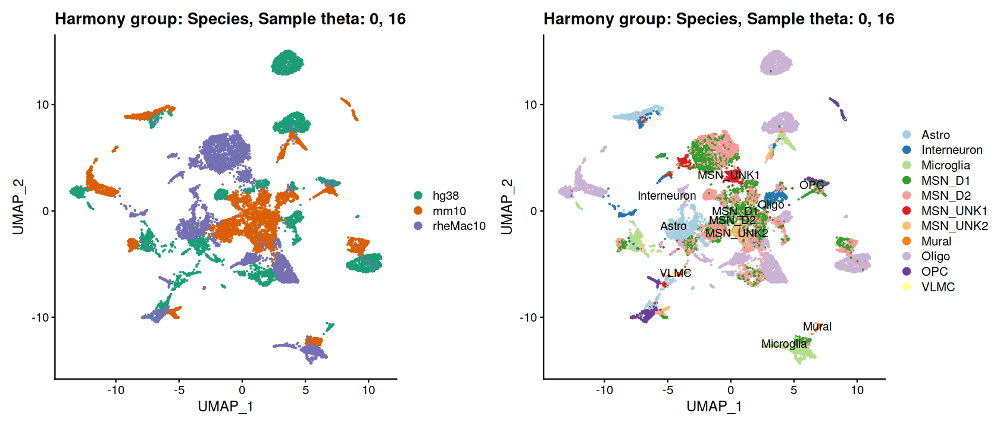

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



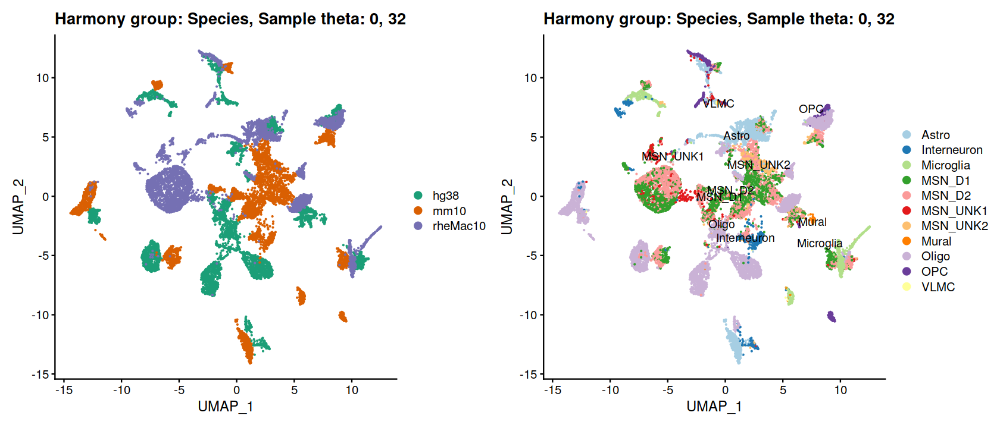

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



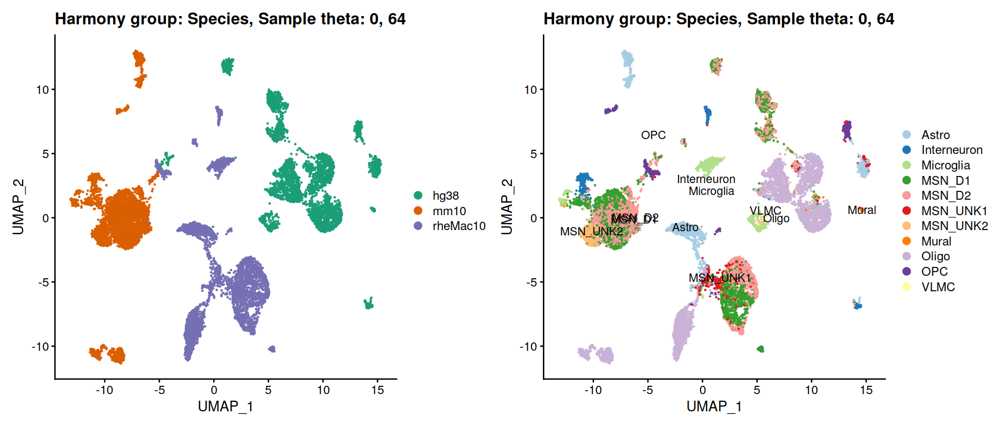

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



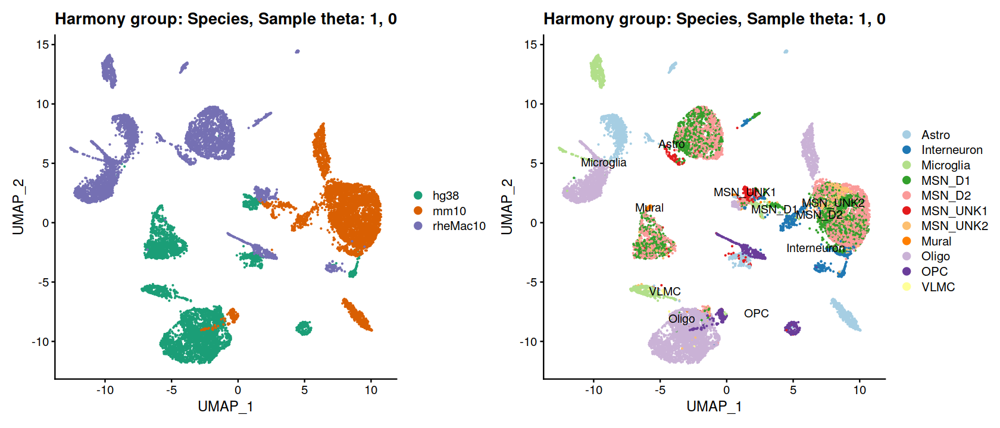

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



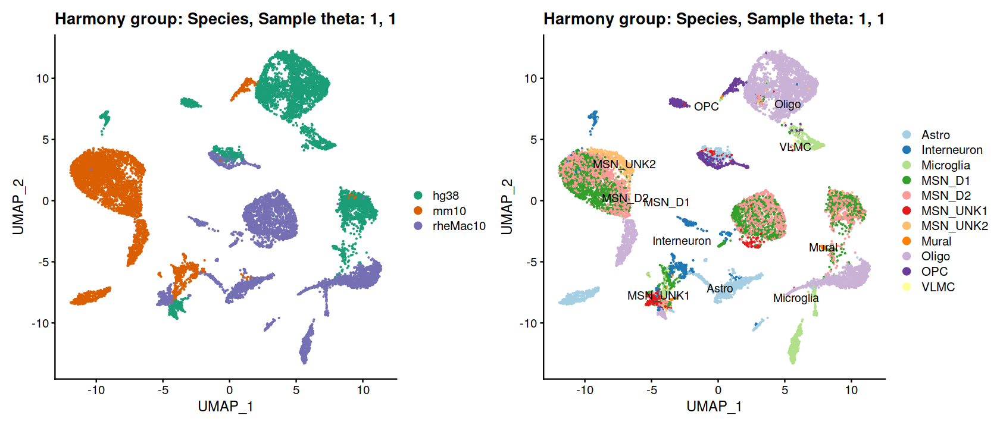

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



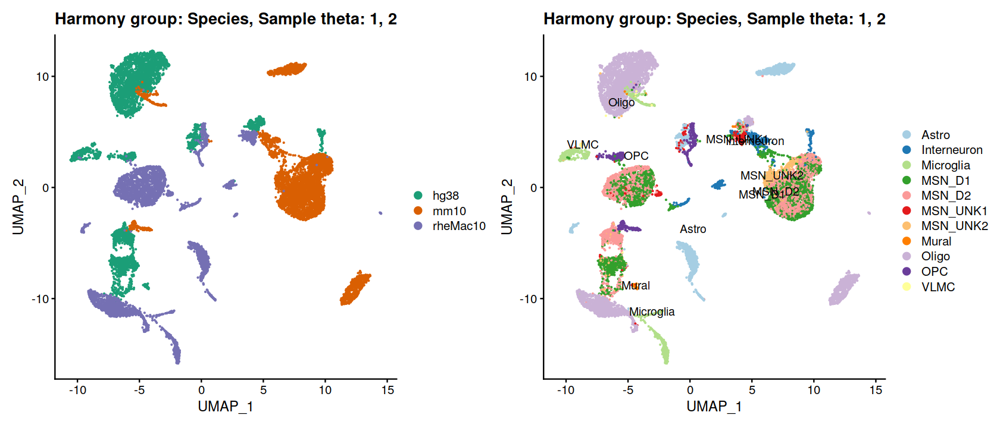

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



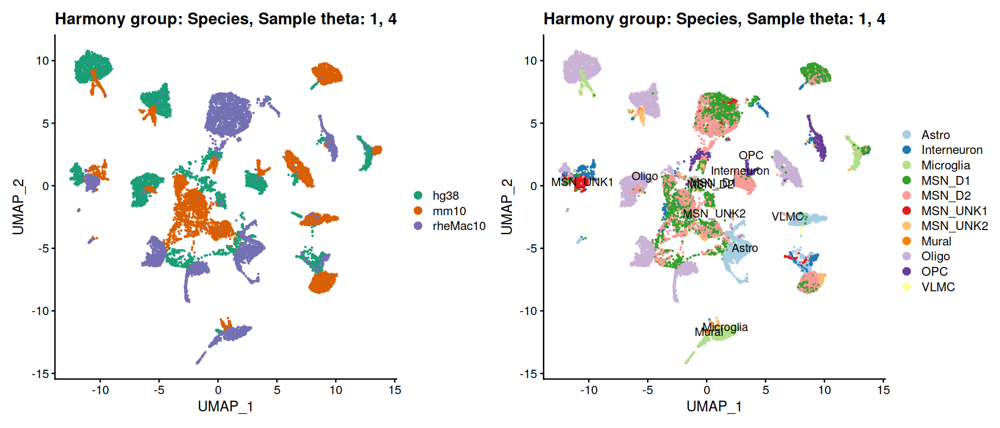

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



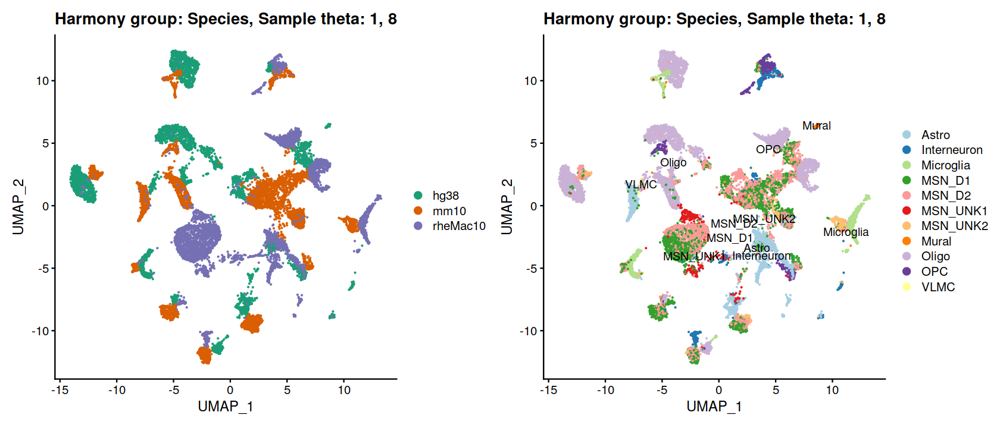

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony converged after 4 iterations



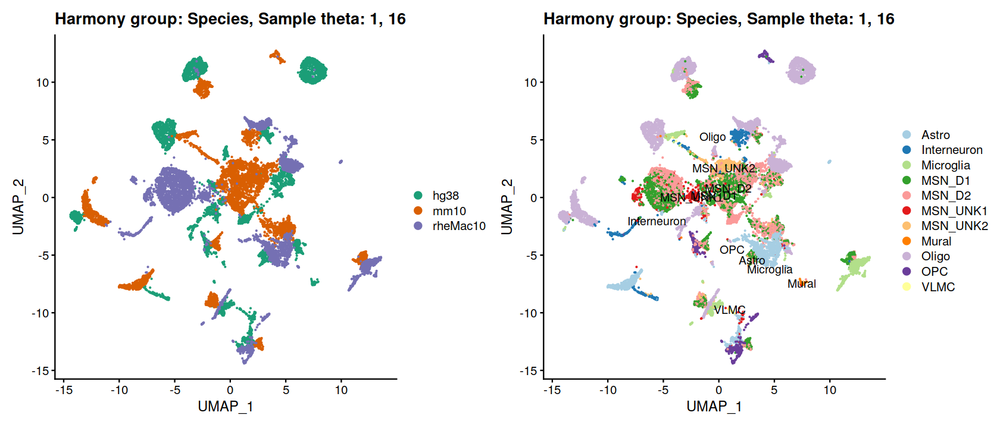

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



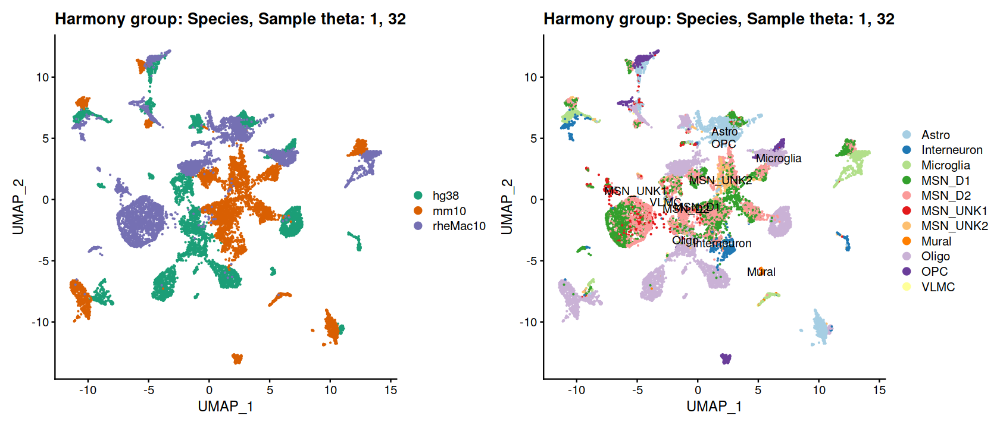

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



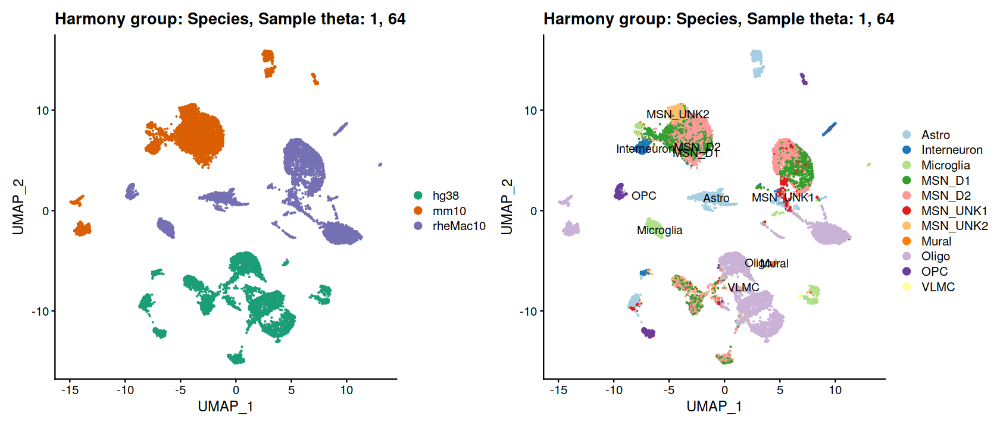

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



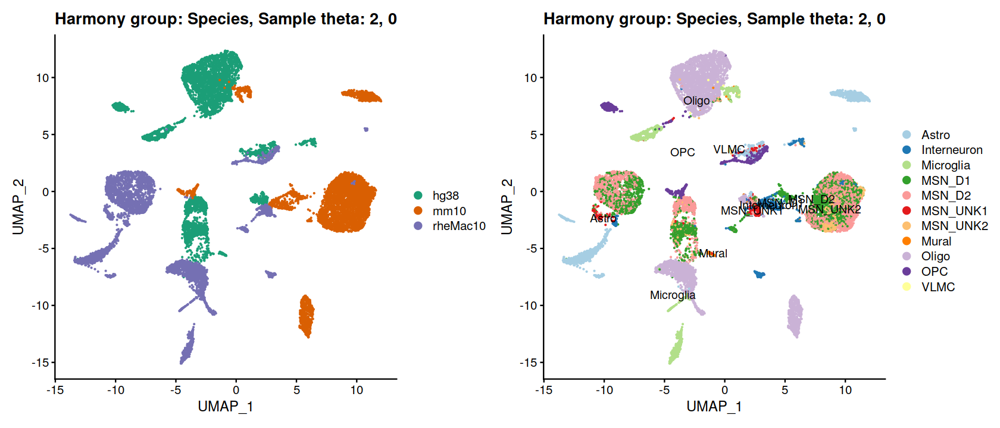

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



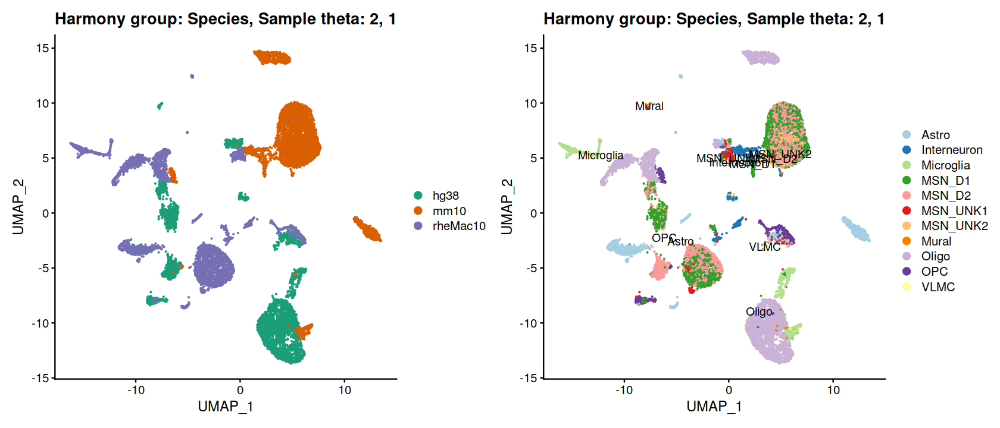

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



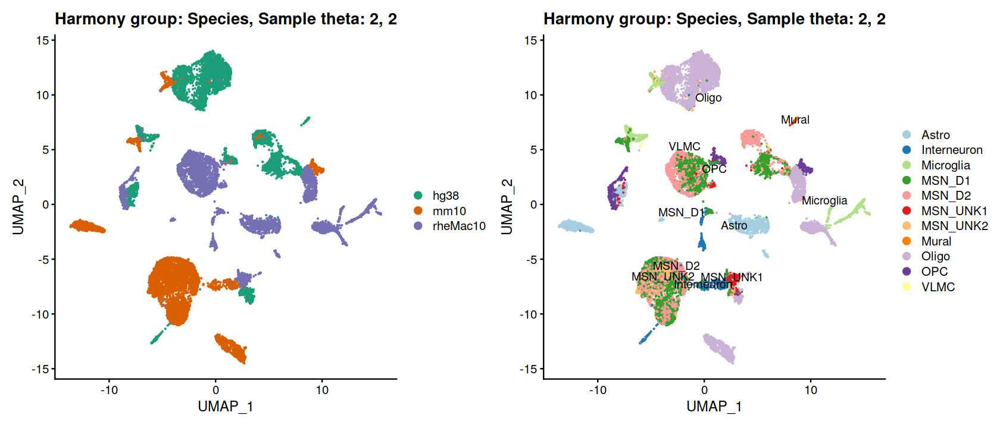

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



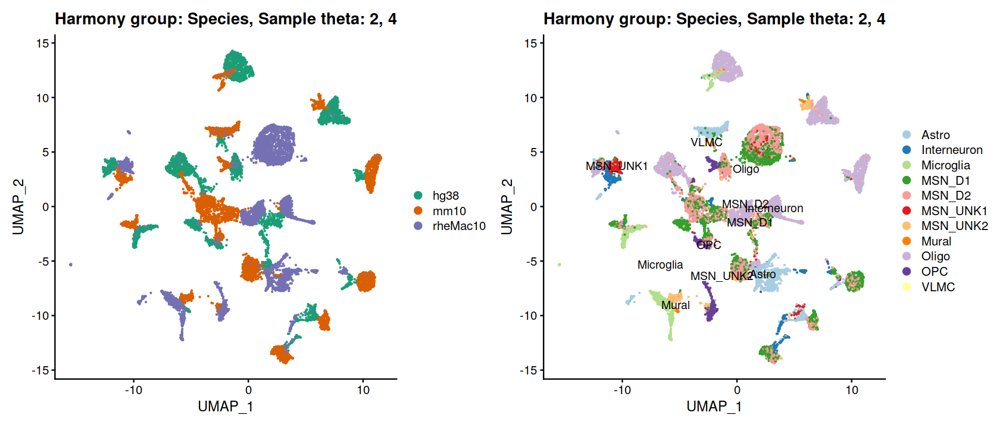

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



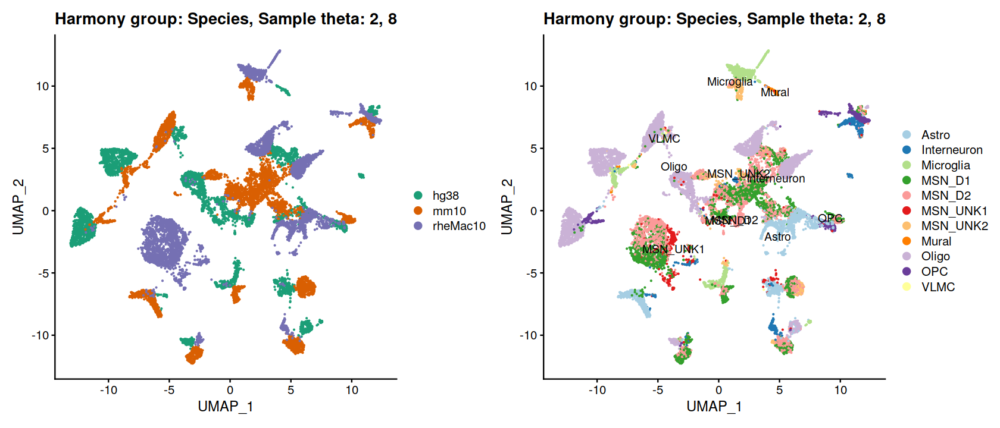

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



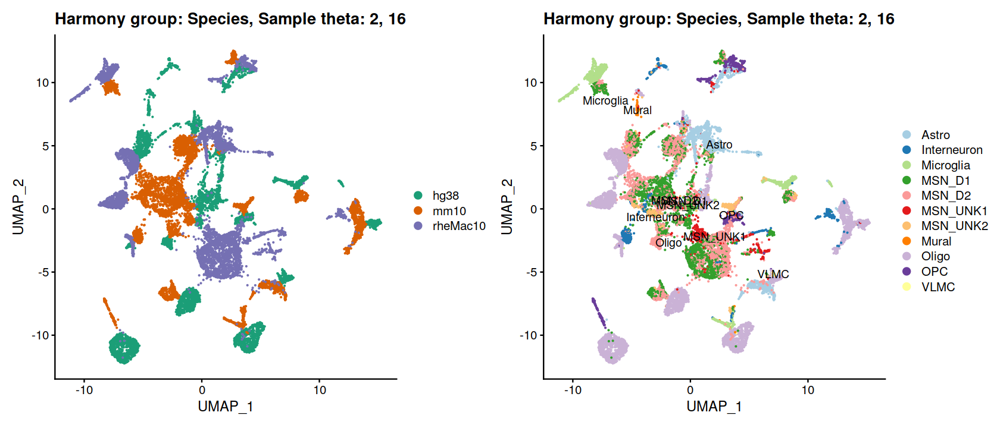

Harmony 1/20

Harmony 2/20

Harmony converged after 2 iterations



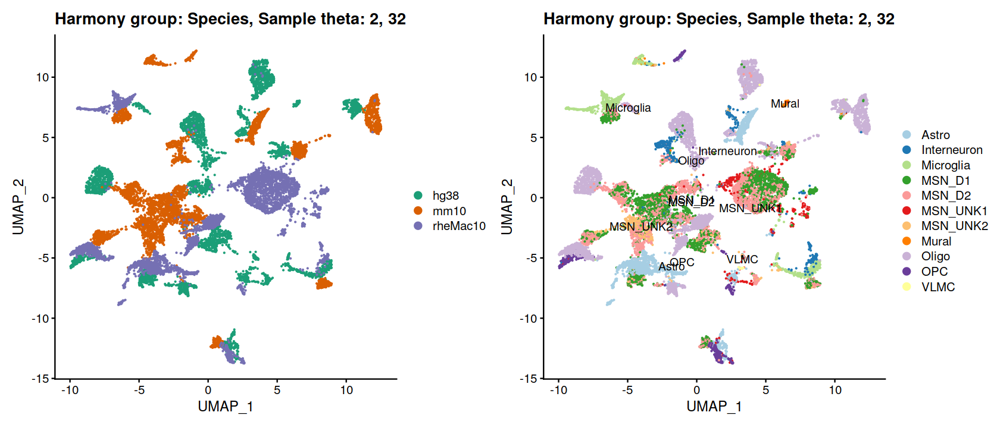

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



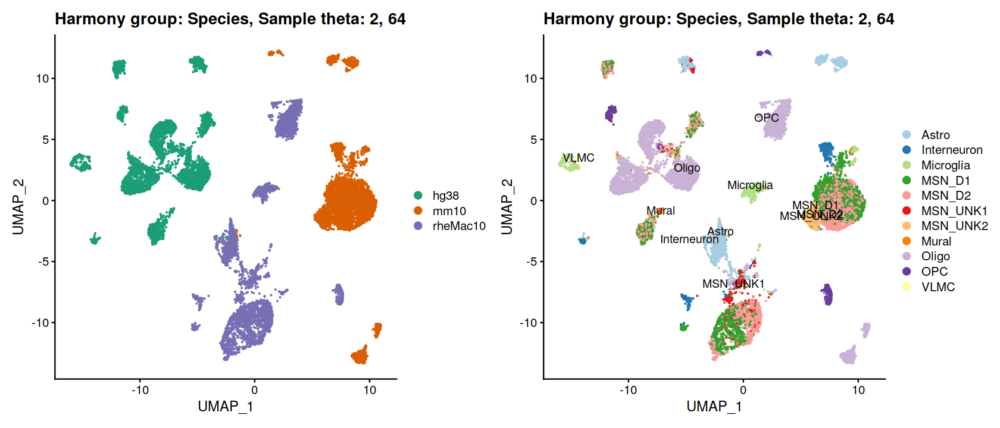

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



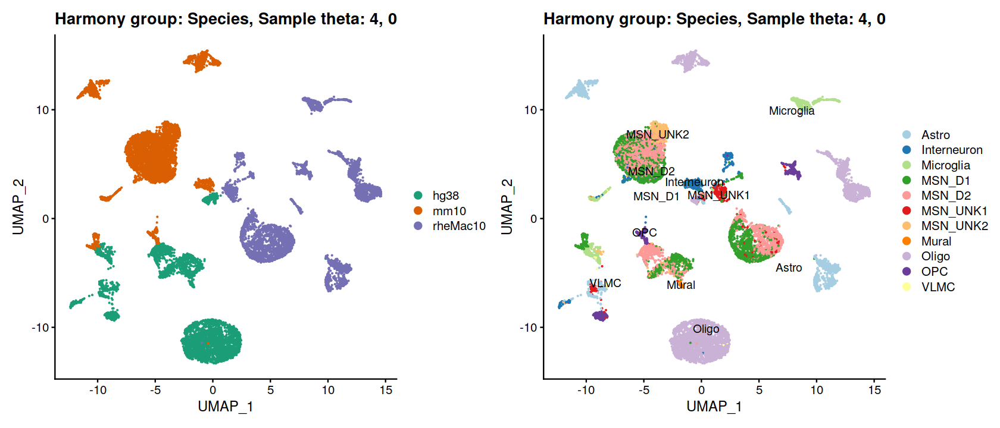

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



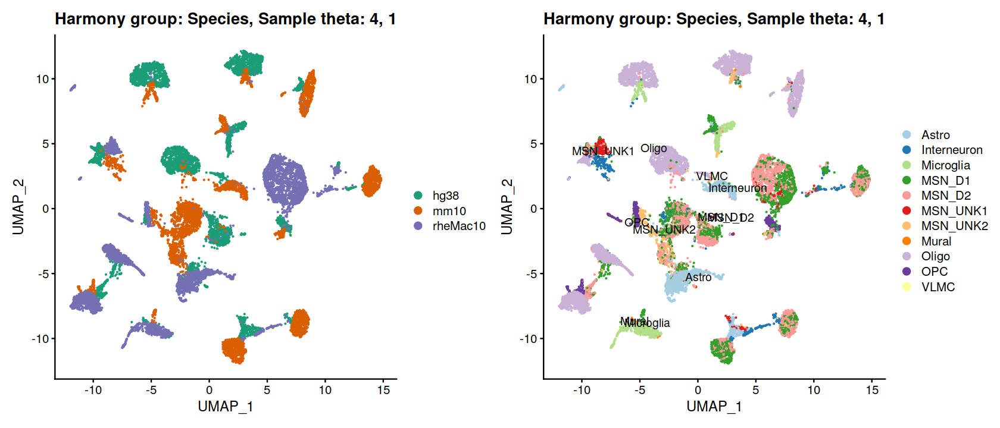

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony converged after 10 iterations



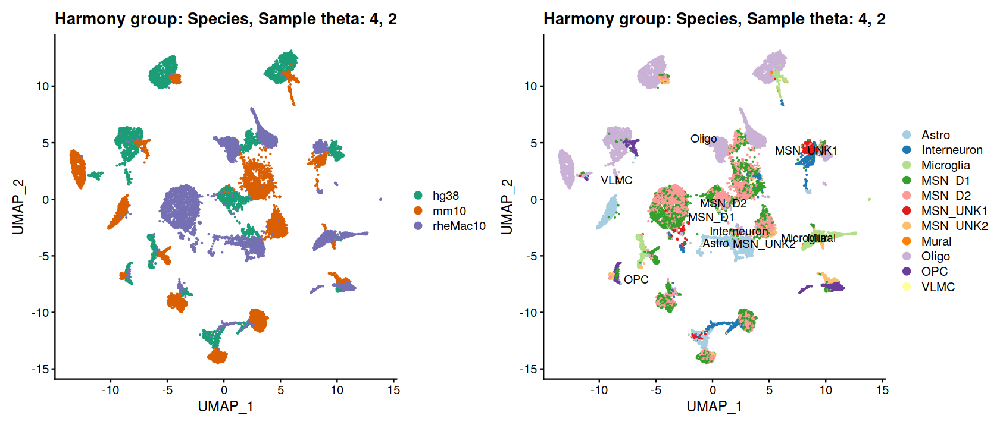

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



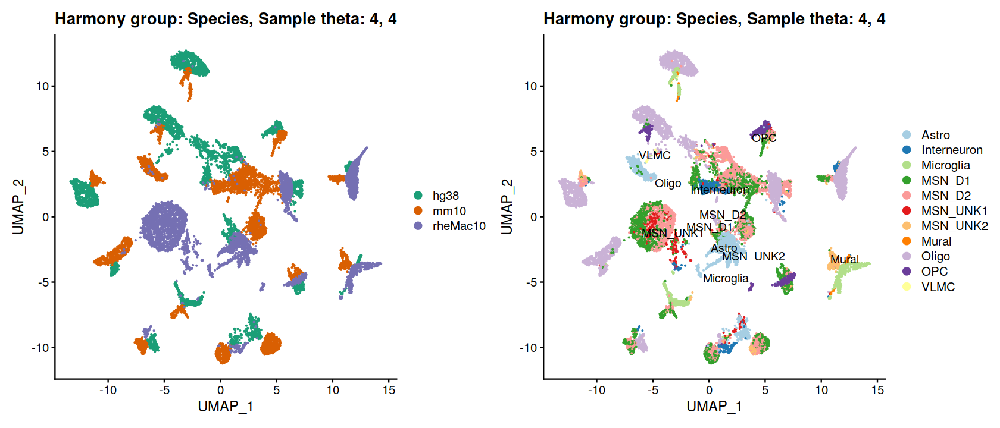

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony converged after 13 iterations



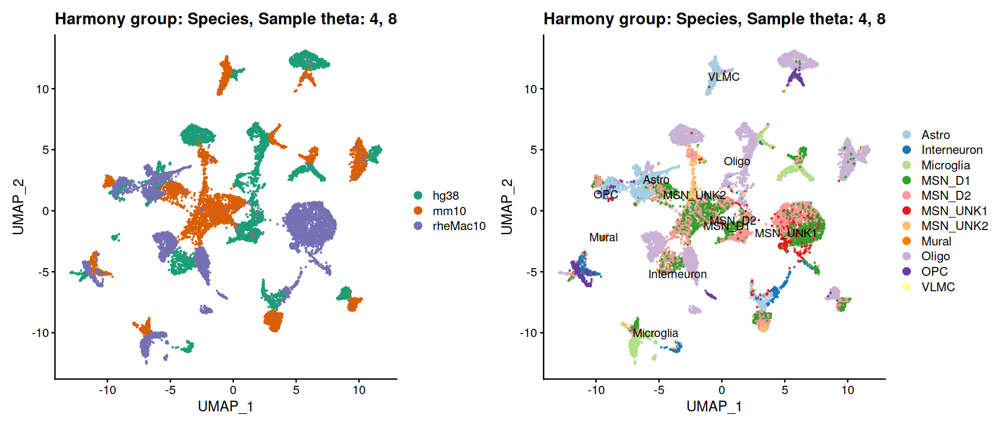

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony converged after 5 iterations



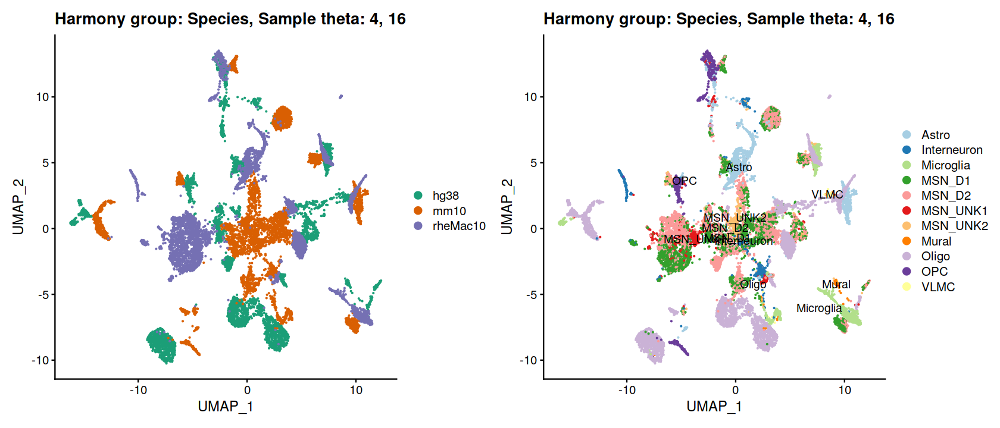

Harmony 1/20

Harmony 2/20

Harmony converged after 2 iterations



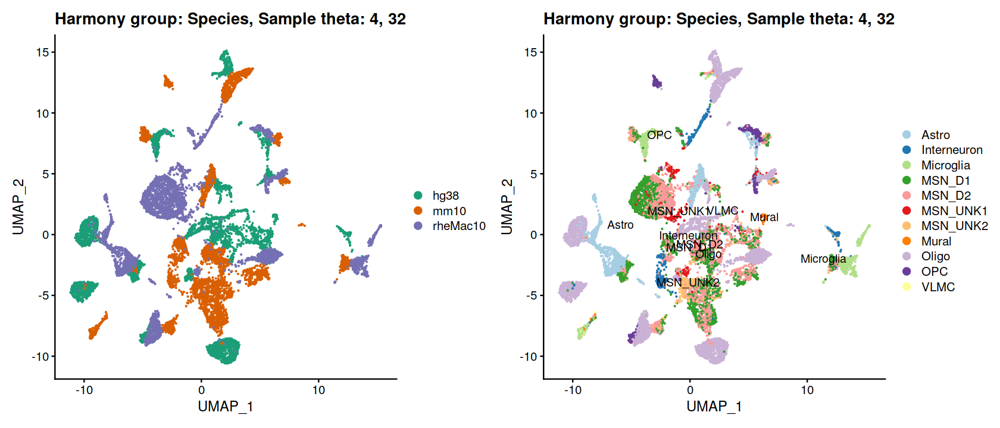

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



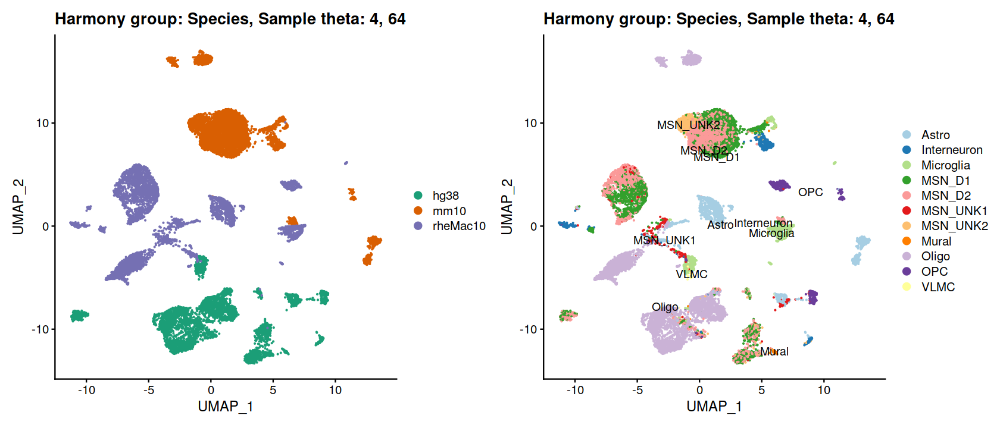

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



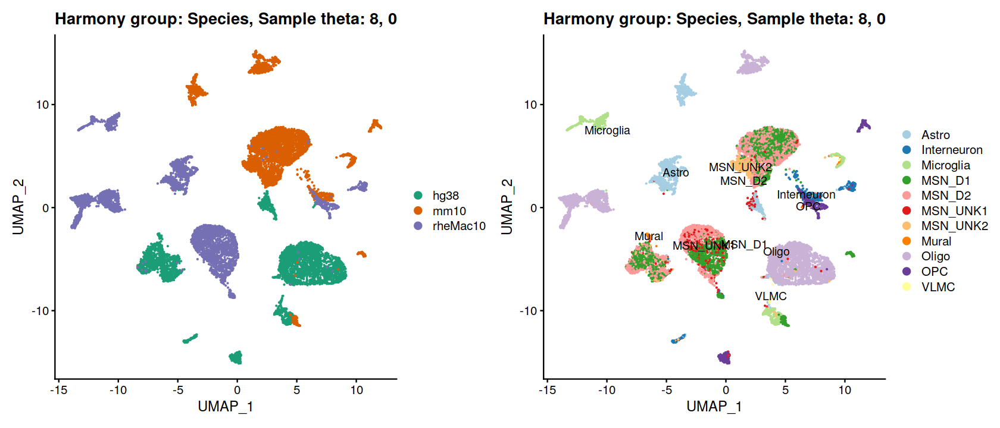

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



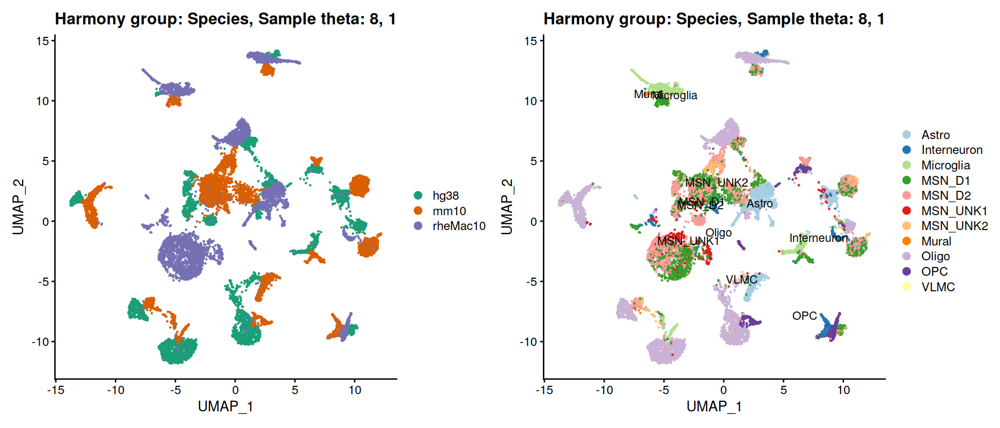

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony converged after 9 iterations



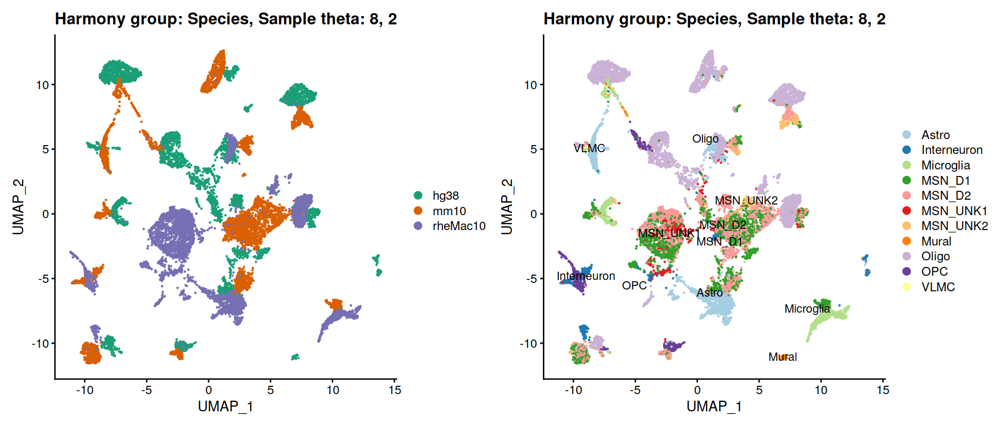

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



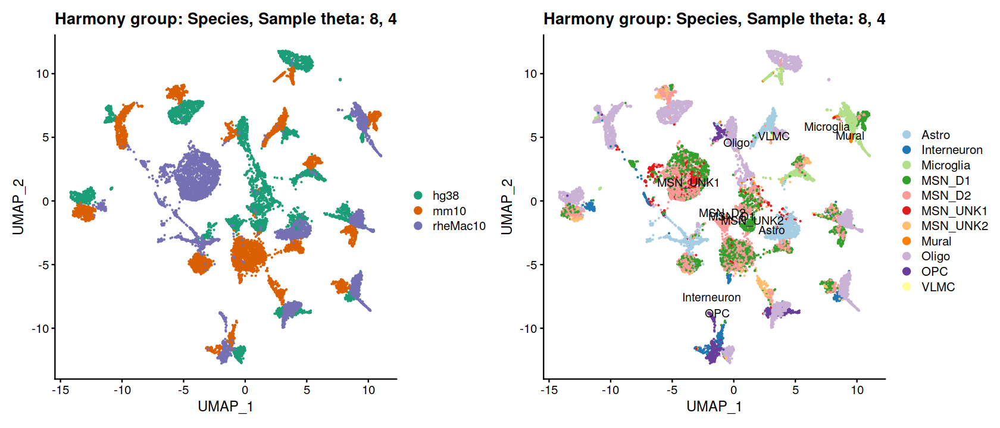

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony converged after 8 iterations



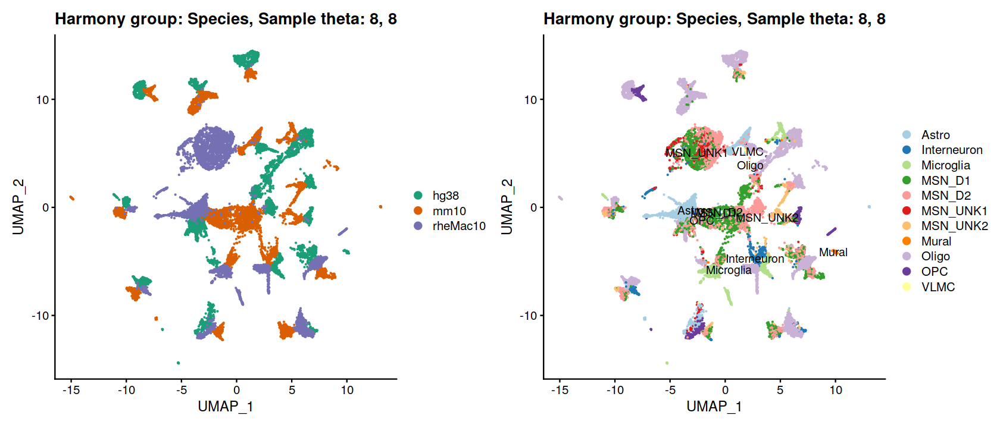

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony converged after 4 iterations



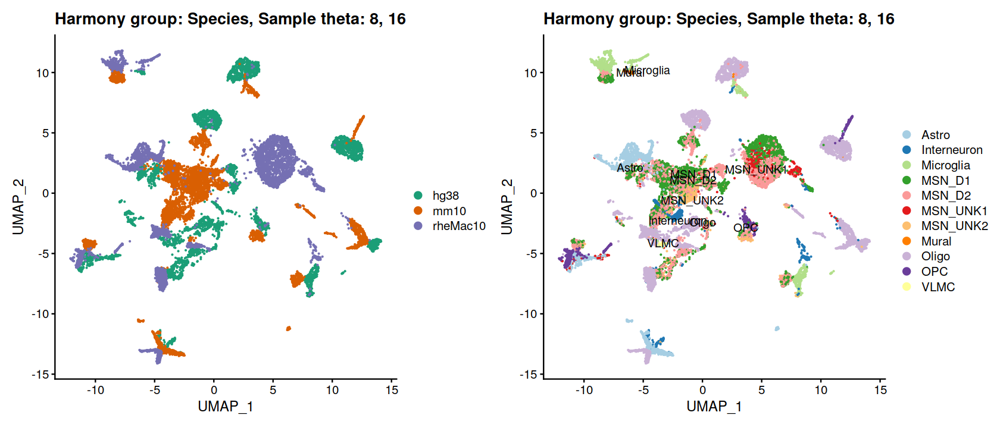

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



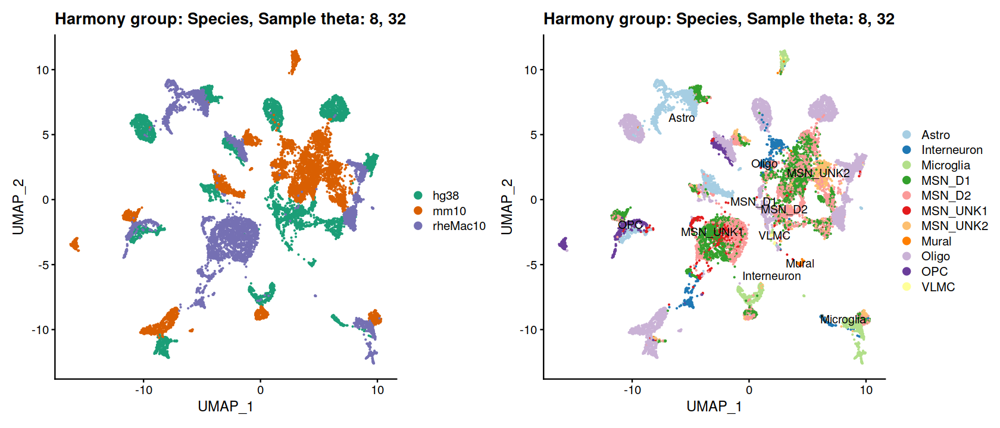

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony converged after 13 iterations



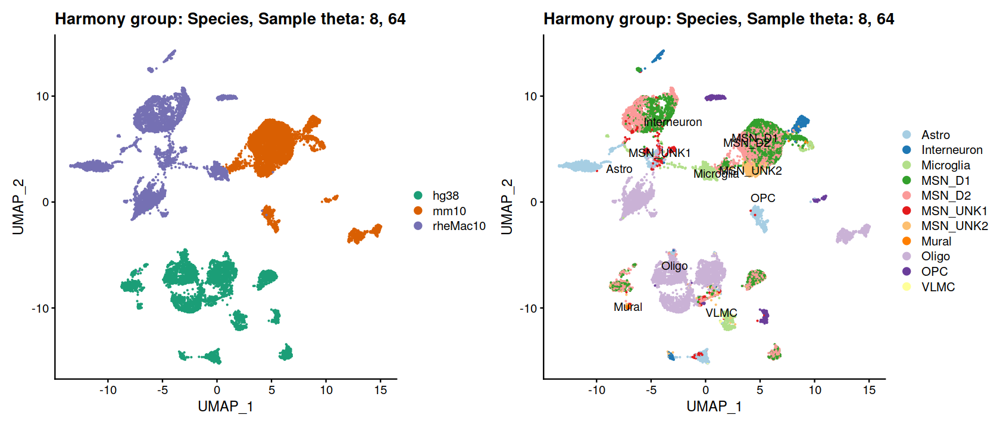

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony converged after 12 iterations



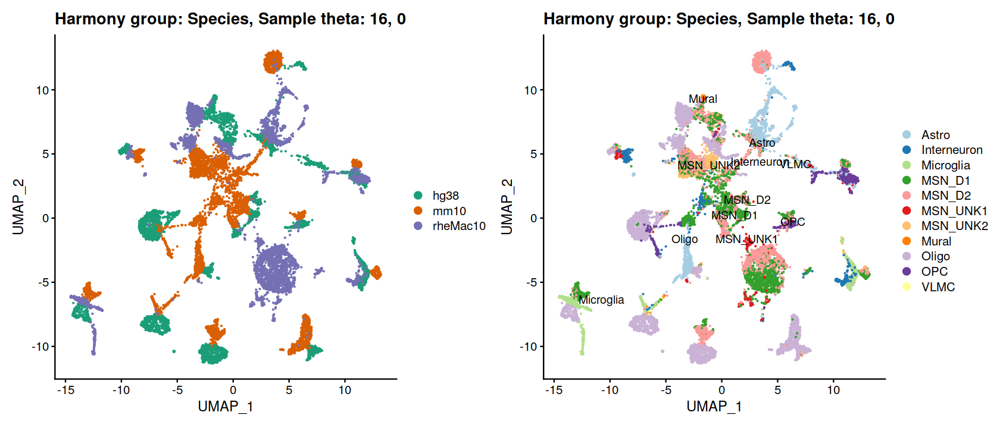

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony converged after 11 iterations



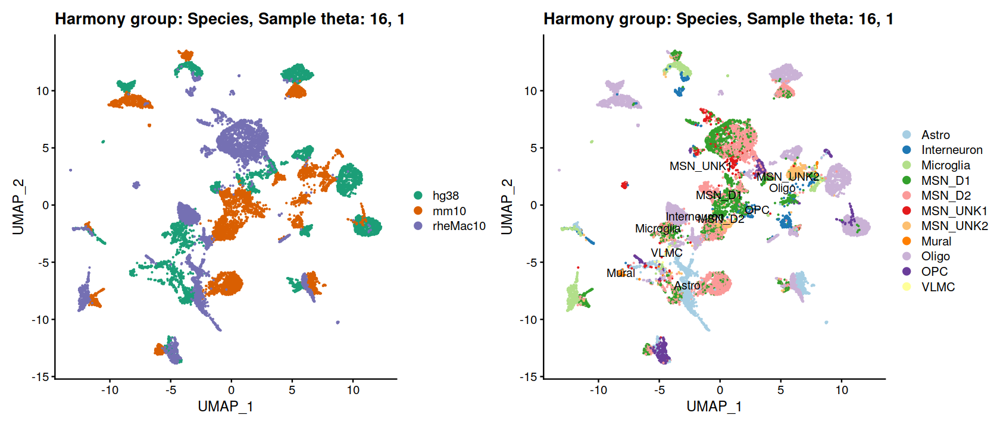

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony converged after 10 iterations



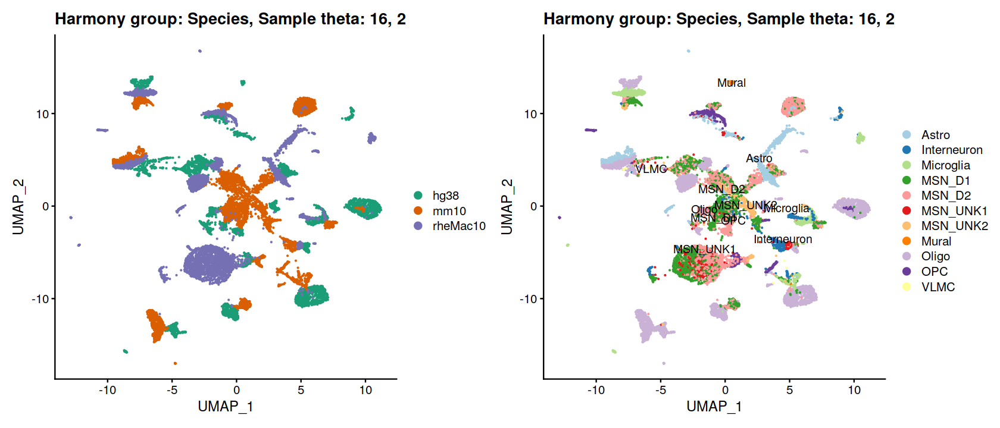

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



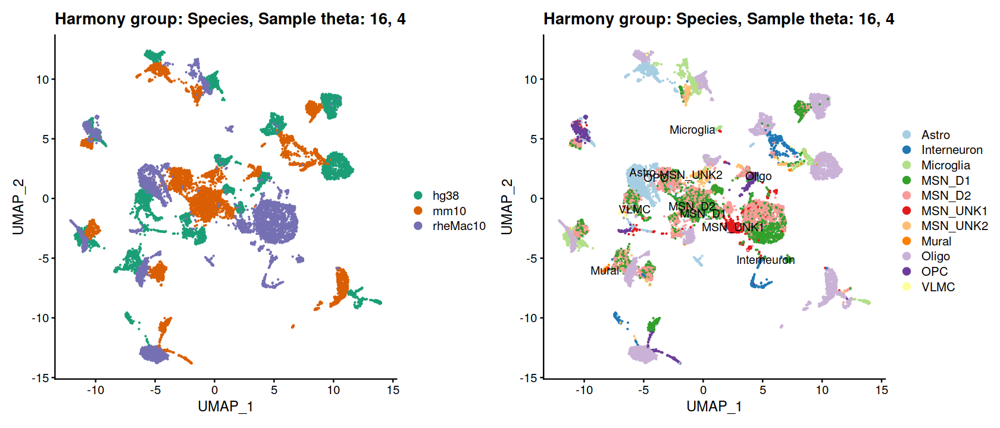

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



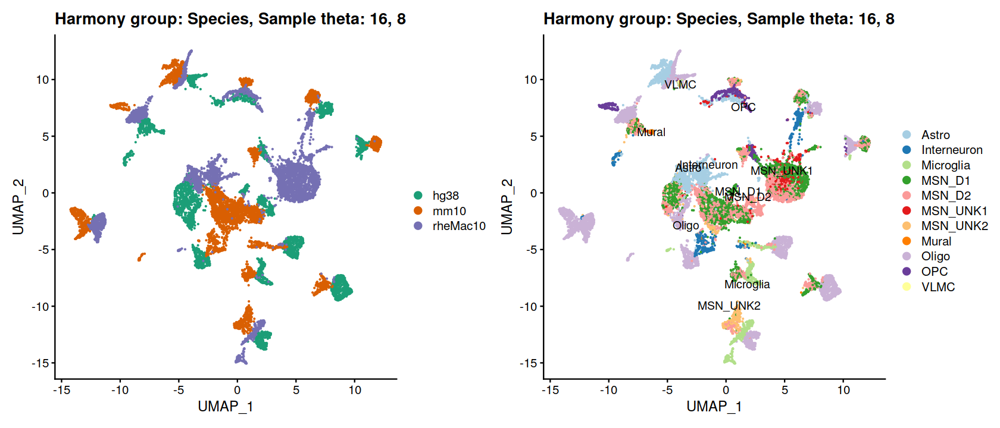

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



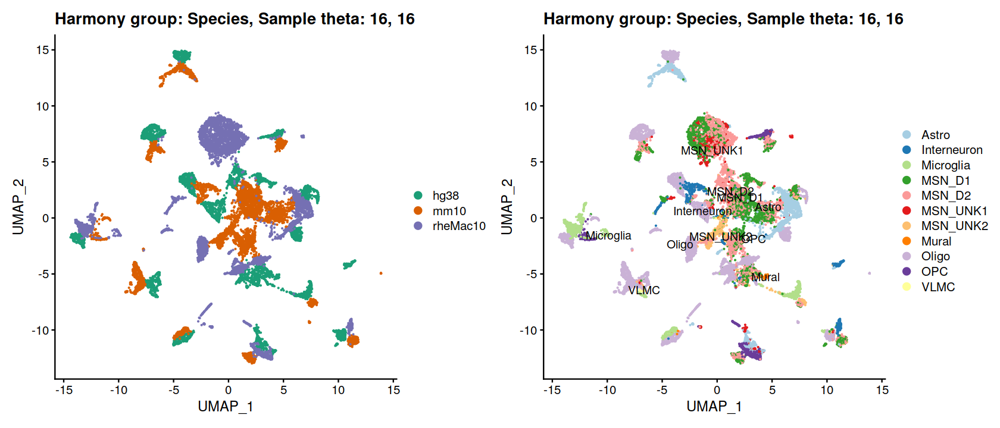

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



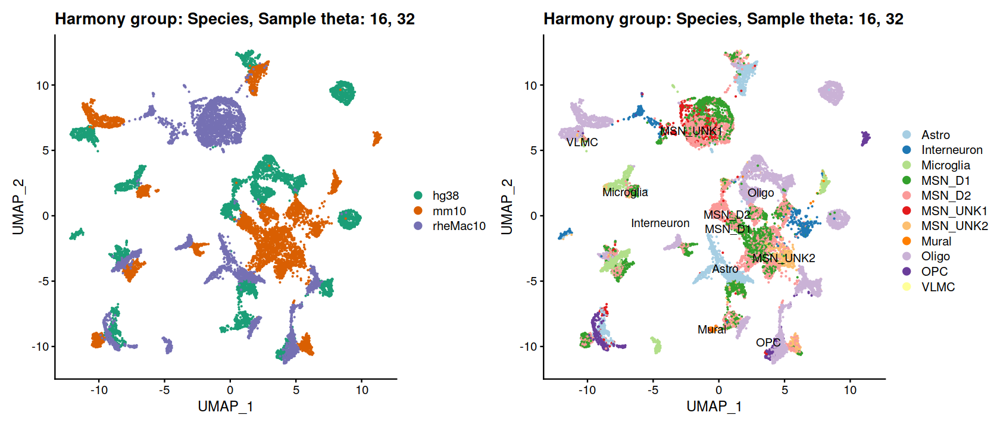

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony 14/20

Harmony 15/20

Harmony 16/20

Harmony converged after 16 iterations



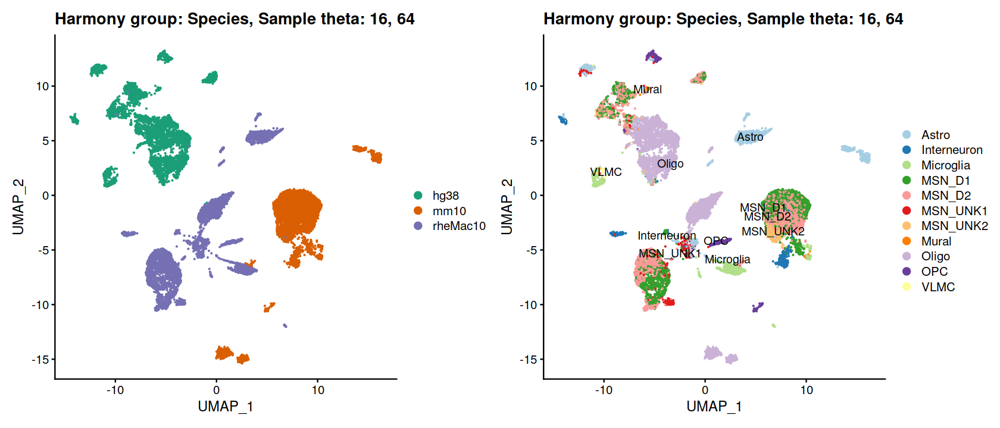

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



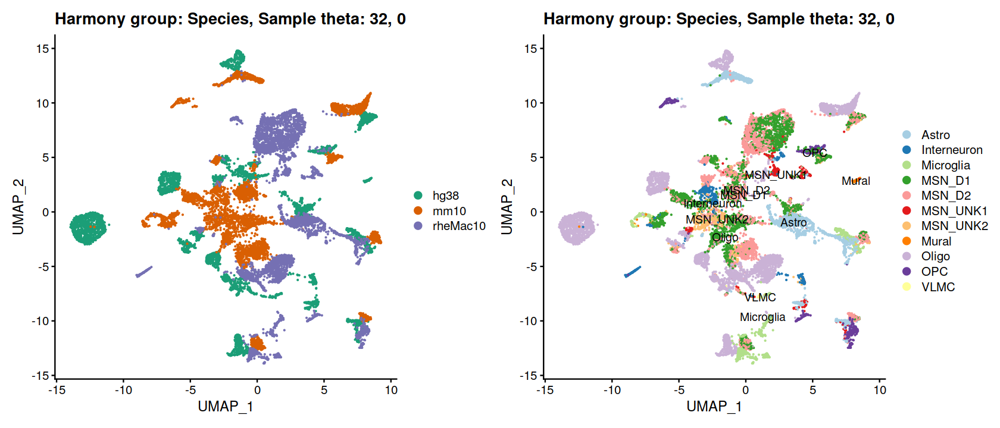

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony 14/20

Harmony 15/20

Harmony 16/20

Harmony converged after 16 iterations



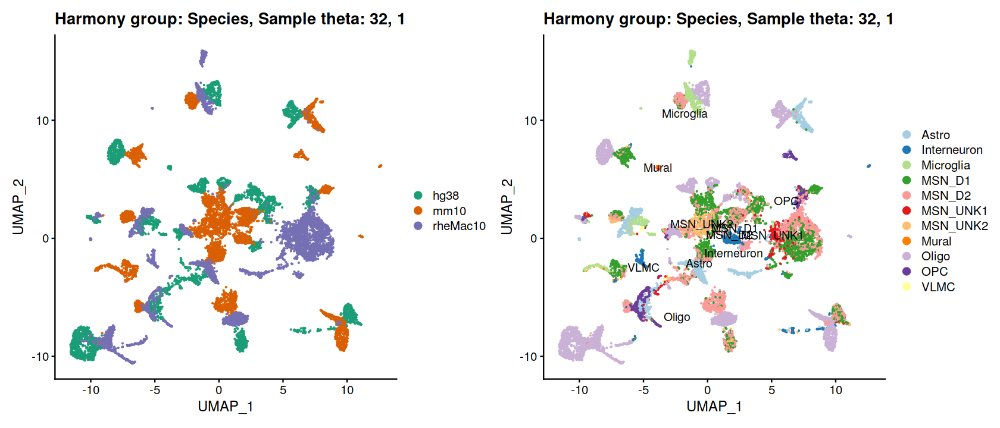

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony converged after 13 iterations



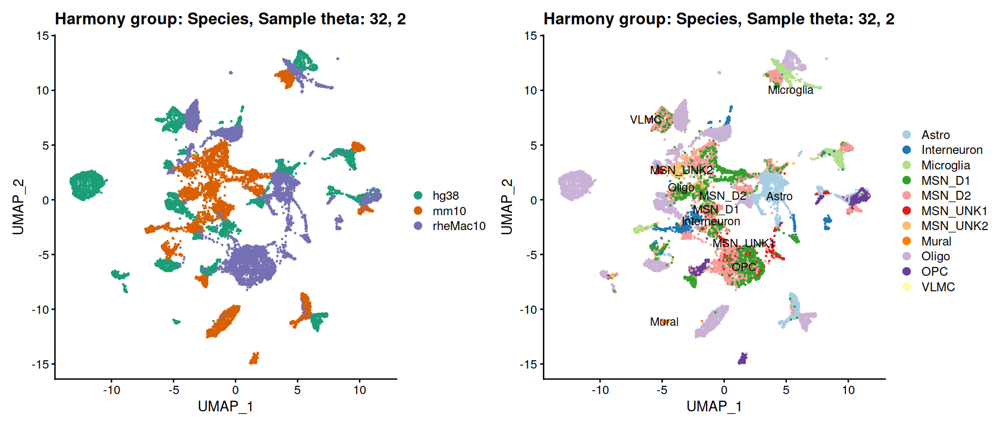

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



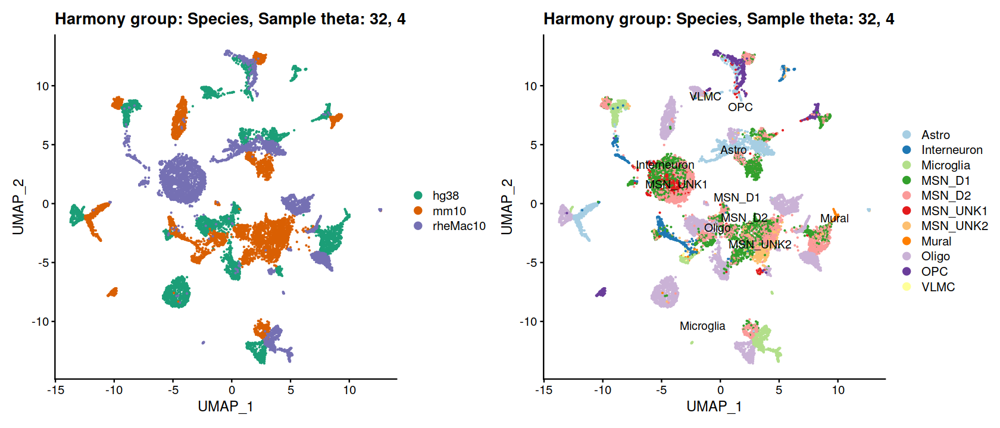

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony converged after 6 iterations



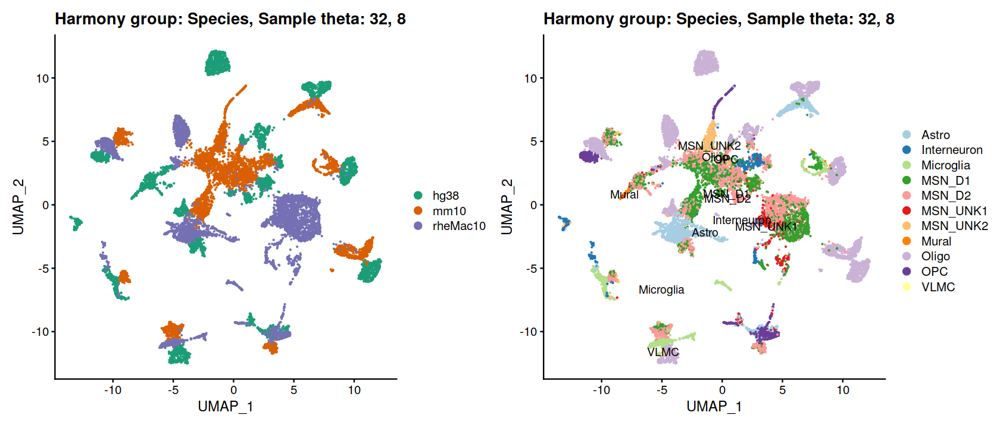

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony converged after 5 iterations



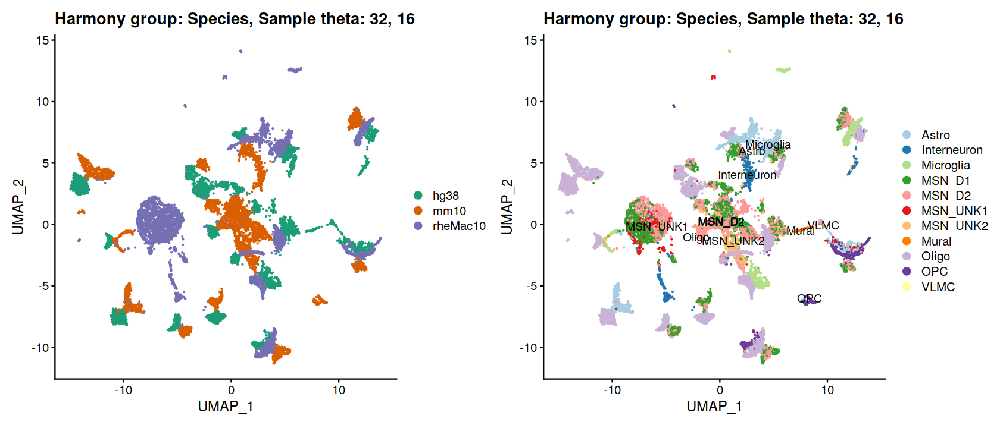

Harmony 1/20

Harmony 2/20

Harmony converged after 2 iterations



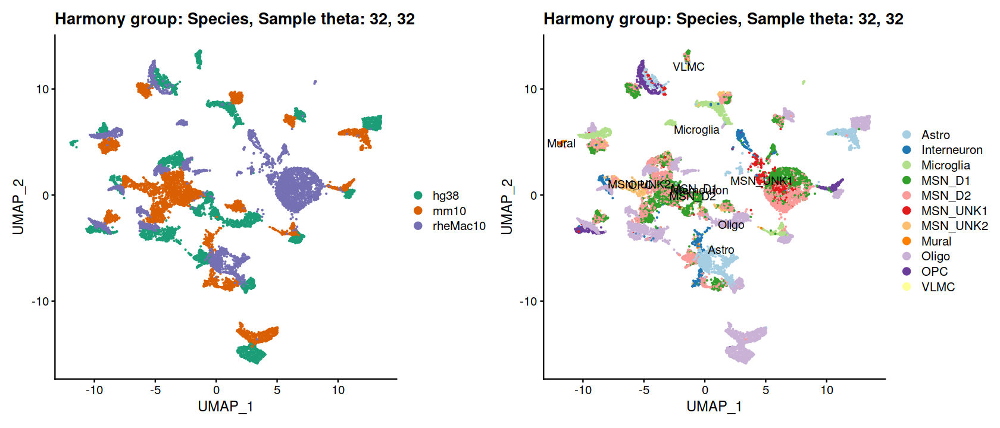

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony converged after 12 iterations



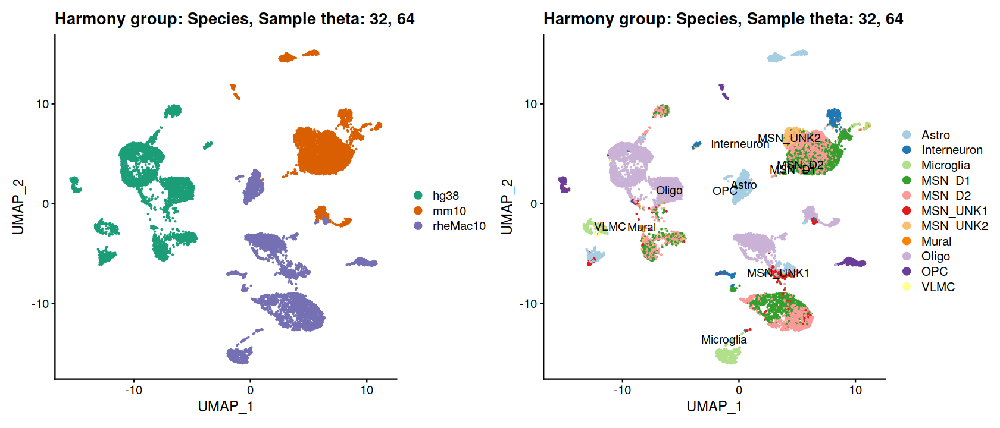

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony converged after 4 iterations



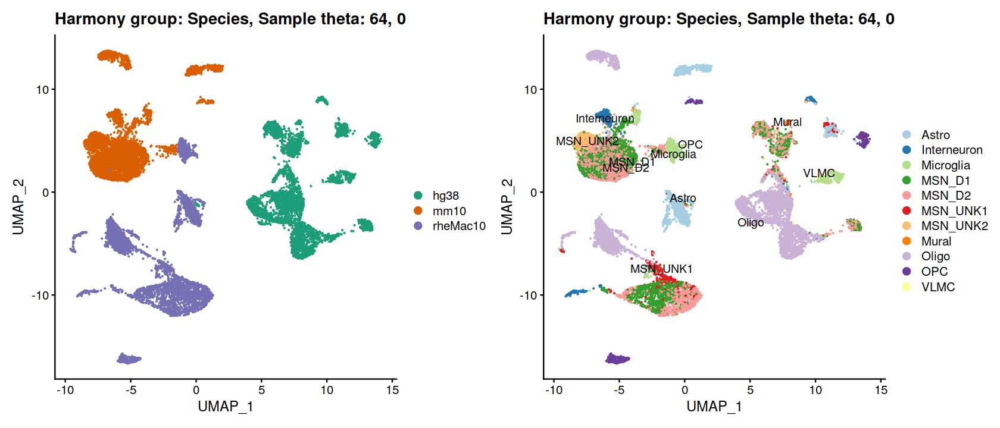

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony converged after 3 iterations



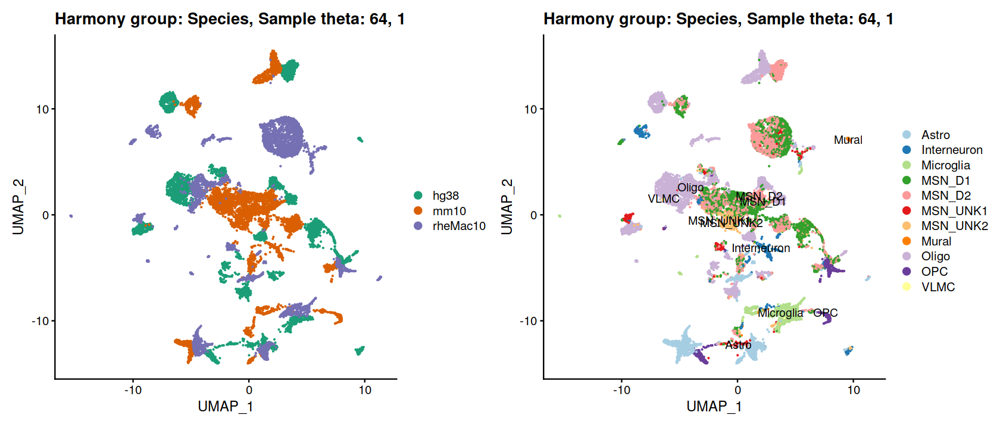

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony converged after 13 iterations



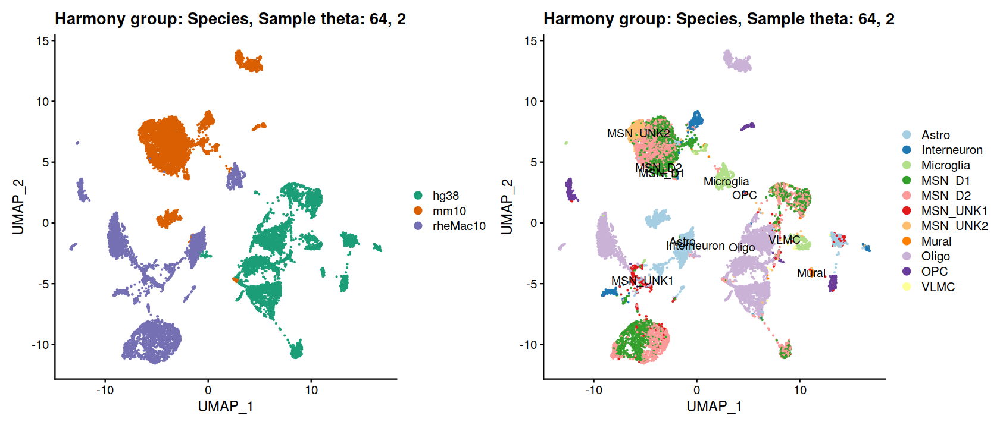

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony converged after 4 iterations



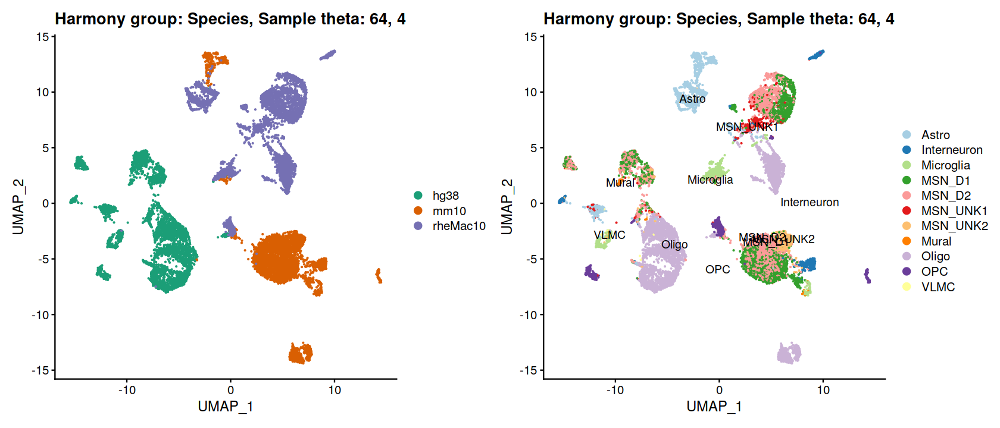

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony converged after 7 iterations



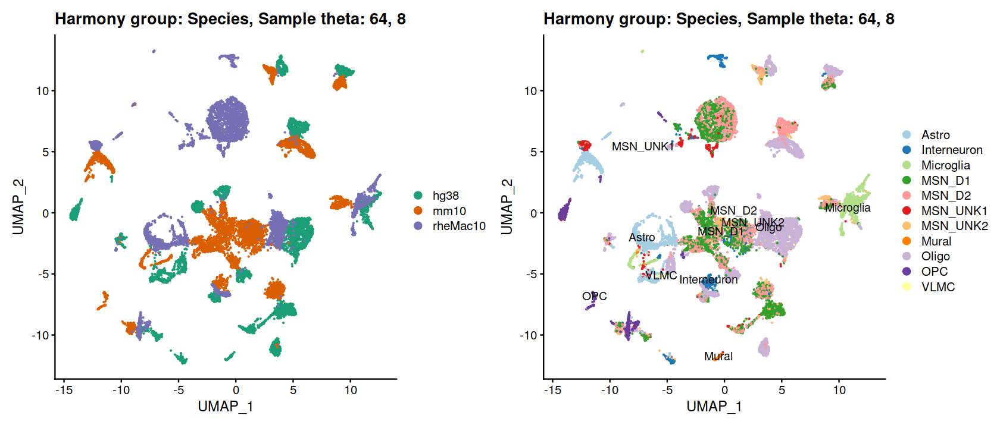

Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony converged after 4 iterations



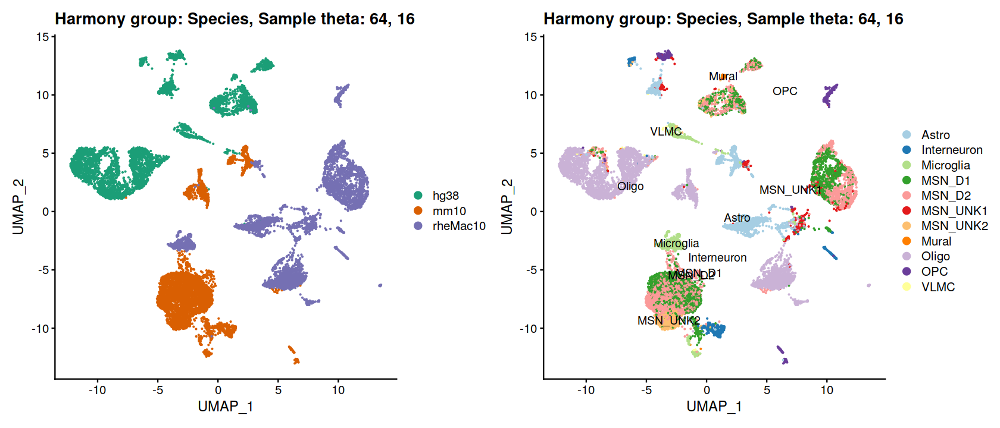

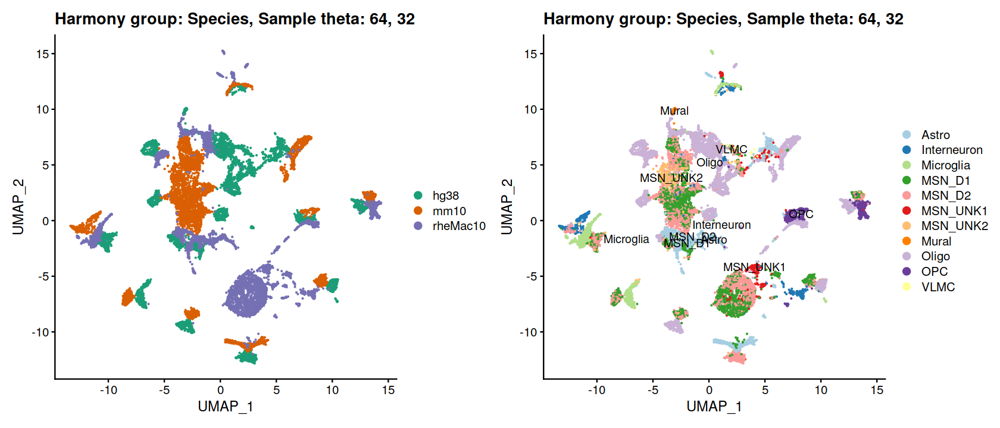

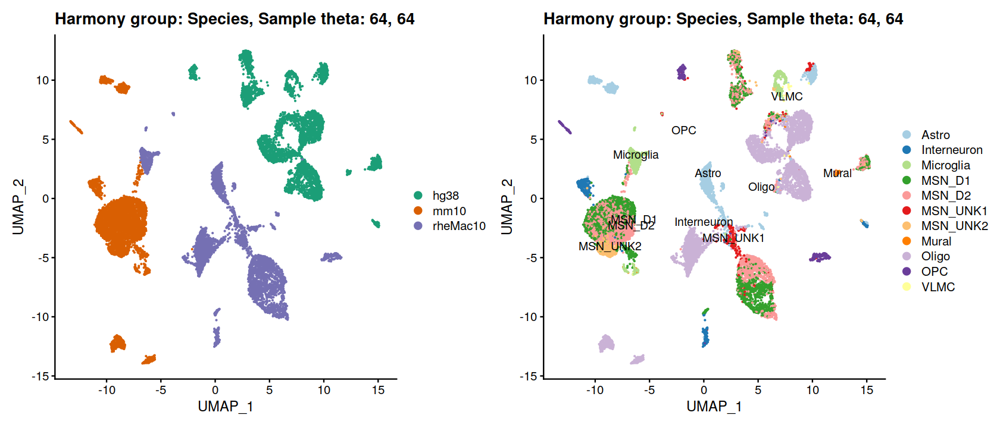

In [11]:
for(thetaSpecies in c(0,2^(0:6))){
    for(thetaSample in c(0,2^(0:6))){
        p = harmonize(obj = subsetObj_seurat,
                      group.by.vars = c('Species', 'Sample'), 
                      theta = c(thetaSpecies, thetaSample))
        print(p)
    }
}